# Project 5 - Image Denoising 

[Project 5](https://jllottes.github.io/Projects/image_denoising/image_denoising.html)

# Introduction

Images are a 2-dimensional representation of visual perception. Images are made up of a distributed amplitude of colors. Image noise is random variation in the brightness/color data of an image. Due to the desire of many to have pictures that are clear and sharp,  noise is very undesireable as it obscures the desired information in an image. Image noise can be generated by the internal image sensor and circuitry in a camera and can range from tiny, almost unnoticeable specks to images that are almost entirely made up of noise and contain a much smaller amount of useable data.

The goal of this report is to look at how image noise works. We will first introduce noise onto an image and then explore the different methods of removing noise and restoring the image to its original state.

# Salt and Pepper Noise

Impulse noise, sometimes referred to as salt-and-pepper noise or spike noise, is distortion of an image where there will be black pixels in brighter regions of the image, and white pixels in darker regions of the image. Salt and pepper noise can be caused by analog-to-digital conversion errors, and errors leading to image data corruption during data transmission. Impulse noise can be easily recognizeable by tiny black and white specks all over an image. 

In [27]:
import matplotlib.pyplot as plt
import numpy as np
import math

In [28]:
%config InlineBackend.figure_format = 'retina' # Used to sharpen image

The method `showImage` will be used throughout this report to display images in a large size to easily view:

In [48]:
def showImage(image):
    plt.figure(figsize=(10,10))
    plt.imshow(image,cmap='gray')
    plt.show()

# Adding Salt and Pepper Noise to an Image

The method below, `sp_noise`, will add impulse noise to an image. It will take two parameters -- one being the image to be modified, and the other represent the percent of pixels that will recieve salt and pepper noise. Below is an example of `sp_noise` adding $5$% of impulse noise to an image.

In [49]:
def sp_noise(image=np.ndarray,percent=float):
    newImage = image/255 # Image values need to be between 0 and 1
    noise = np.random.rand(newImage.shape[0],newImage.shape[1]).astype(float) # Array of random #'s
    salt = (noise < (percent/2))
    pepper = (noise > (1-(percent/2)))
    newImage[salt] = 1
    newImage[pepper] = 0
    
    return newImage

In [245]:
face = plt.imread('face.png')

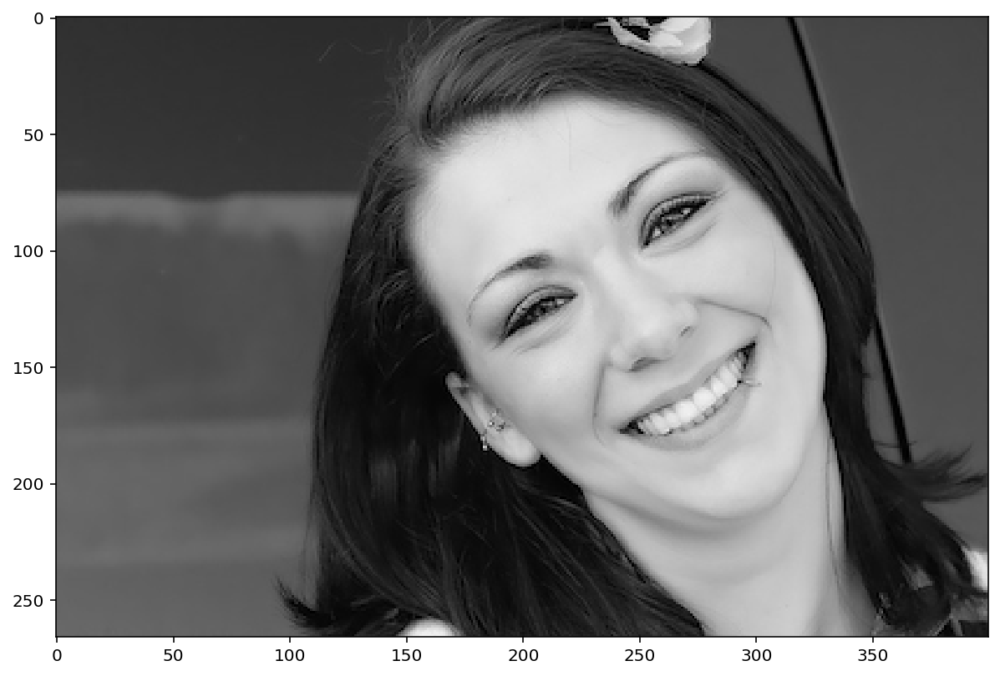

In [246]:
showImage(face)

In [247]:
face = face[:,:,0]*255
impulseFace = sp_noise(face,0.05)

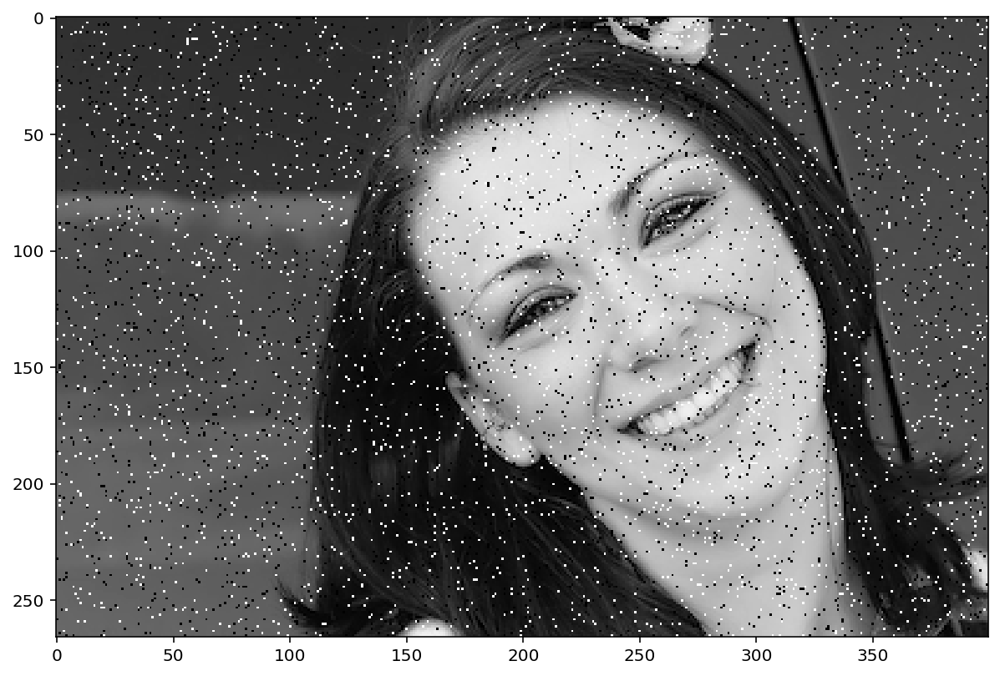

In [248]:
showImage(impulseFace)

As you can see above, even adding only $5$% of salt and pepper noise can heavily distort an image. The image is now in a state where it is a lot more difficult to identify the woman in the picture. Obviously, images that are in this shape are of much less value than clear and sharp images. There are several methods to remove noise from an image and restore it much closer to its original state.

# Image Denoising - Mean Filtering 

Mean filtering is one of the many methods used to de-noise an image. Mean filtering works by iteratively going through the row and columns of the image data (represented by $P[i,j]$), selecting an $n x m$ square of pixels that has $P[i,j]$ at the center, and setting the center pixel equal to the value of the mean of the entire square. Mean filtering can help to blend spikes of image data and help to reduce image noise. `mean_filter()` is the method we will be using to reduce image noise through mean filtering, which takes two arguments -- the image and the size of the square of pixels to be used by the filter.

In [249]:
def mean_filter(image=np.ndarray,kernelSize=float):
    min = kernelSize//2
    max = math.ceil(kernelSize/2) # Want this to be integer, need to round up to ceiling 
    for i in range(min,image.shape[0]-1):
        for j in range(min,image.shape[1]-1):
            square=np.array(image[i-min:i+max,j-min:j+max]) # This needs to fit our kernel size
            if(square[min,min]==1 or square[min,min]==0): # For n*n matrix, center pixel will always be @ 
                                                          # [kernelSize//2,kernelSize//2]
                square[min][min]=np.mean(square)
                image[i-min:i+max,j-min:j+max] = square
                
    return image

But before we can start filtering an image, we must deal with a common problem with image filtering -- **edge pixels**. Because we are looking at every row and column of the image, when we get to the right/left/top/bottom edge of the we run into the problem of not having values for the square pixel's right/left/top/bottom values. To address this issue, we must fix a border around the image so that the square of pixels have values at each position. This border must fit with the size of pixels that we are using for our filter, called the *kernel size*. For example, if we are using a kernel size of $3$, that means that we are using a square of size $3$ rows x $3$ columns, and would have a $1$-pixel pad around the middle pixel. If we set the value of the border size to be: `kernelSize`$//2$, we will correctly calculate the border size needed for the kernel.

The method `addBorder()` takes the original image and border size as its arguments, and first creates a image of white pixels that is the size of the original image + a border around each edge. The original image is then laid on top of white pixel image, and an image with a white border is created.

In [250]:
def addBorder(image=np.ndarray,borderSize=int):
    imageBorder = np.ones((image.shape[0]+(borderSize*2),image.shape[1]+(borderSize*2))) 
    imageBorder[borderSize:-borderSize,borderSize:-borderSize] = image
    return imageBorder

Here is the image of the woman with a 10-pixel border added around each edge:

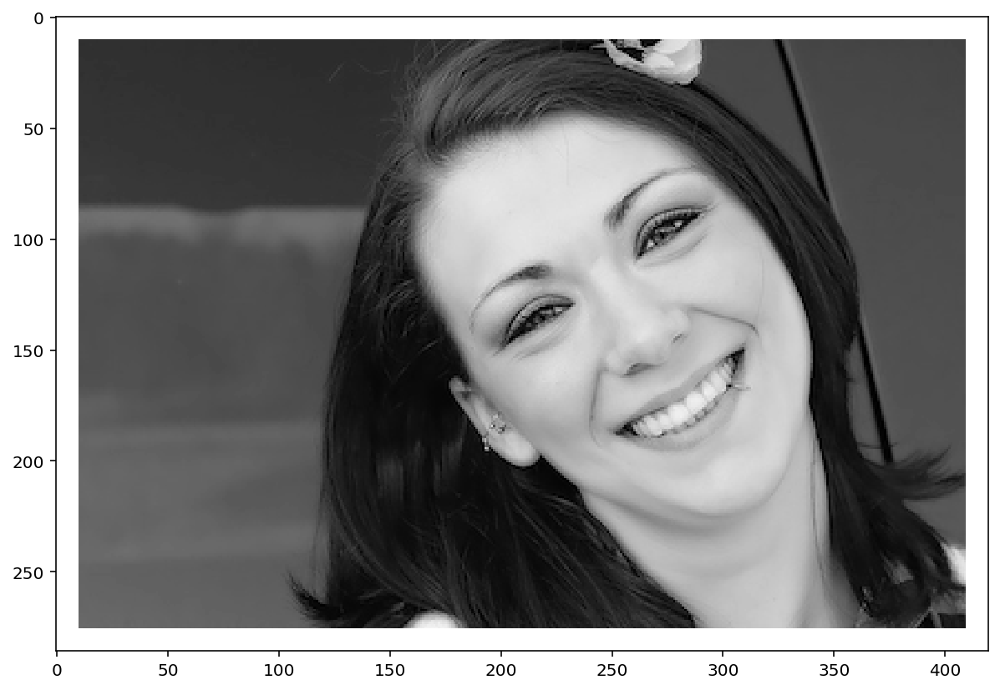

In [251]:
showImage(addBorder(face/255,10))

Now, we will show the mean filter in action. First we start with the original picturethat had $5$% noise added to it:

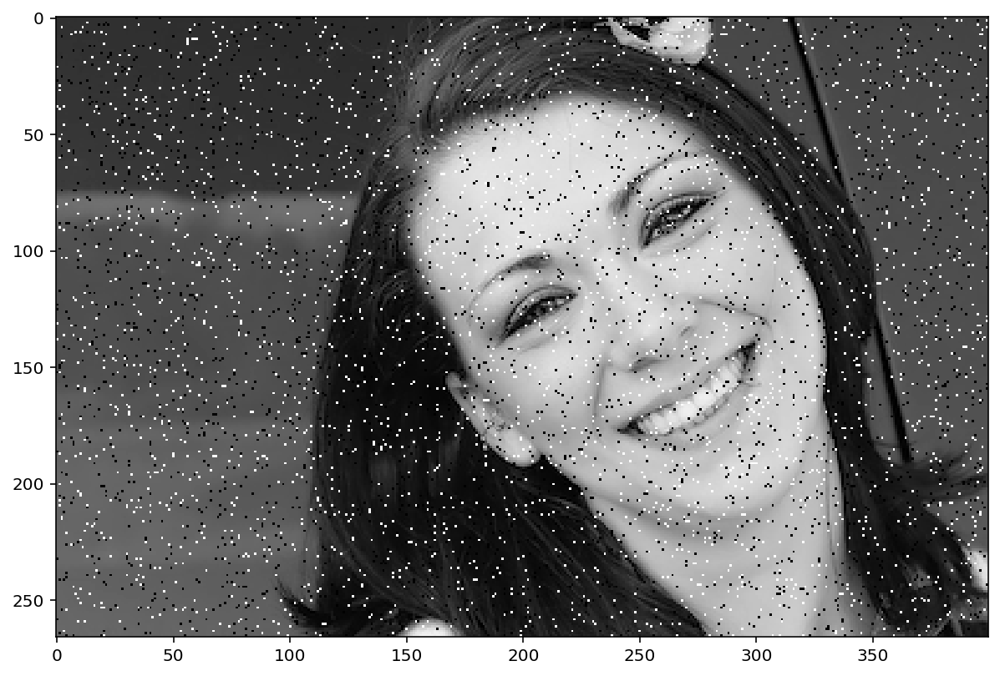

In [252]:
showImage(impulseFace)

We will first start off by using a kernel size of $3$, so the bordersize must be equal to: $3//2=1$.

In [253]:
borderImpulseFace = addBorder(impulseFace,3//2)

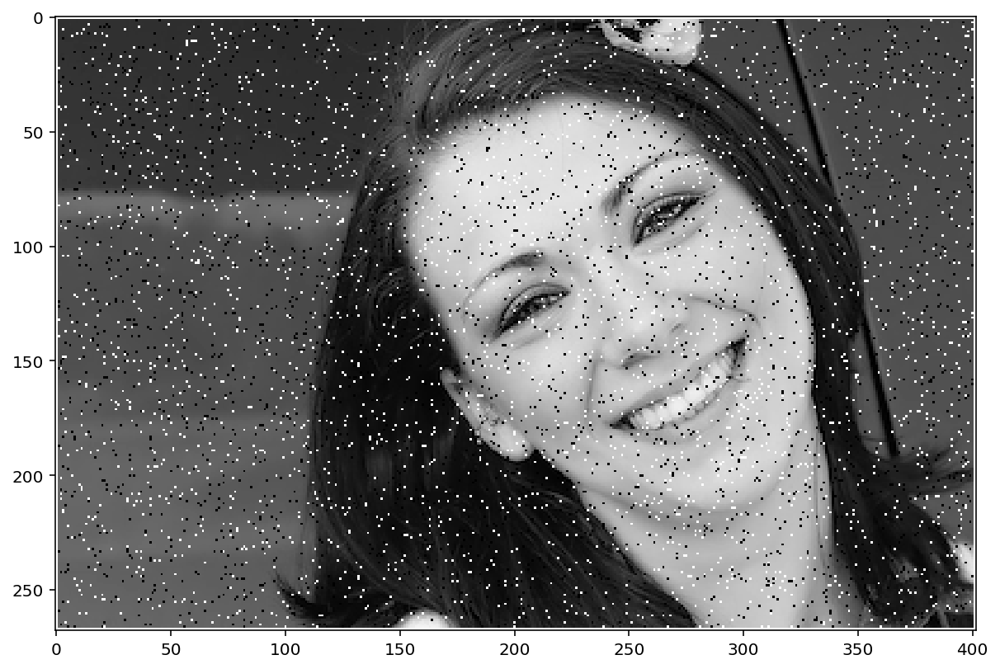

In [254]:
showImage(borderImpulseFace)

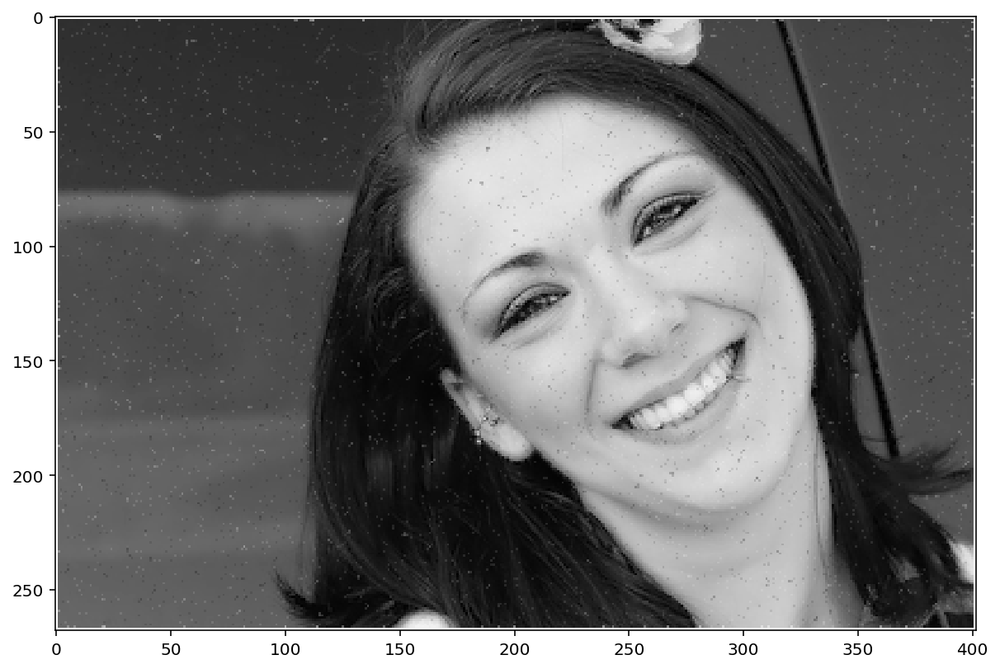

In [255]:
showImage(mean_filter(borderImpulseFace,3))

As you can see, the salt and pepper noise has been greatly reduced, although the clearness and sharpness of the original image has been lost. This is due to the mean filter blending pixel colors together. We will now explore a better method for de-noising images with salt and pepper noise.

# Image Denoising - Median Filtering 

Median filtering is generally known to be the most effective method to reduce salt and pepper noise in an image. The method `median_filter()` will be implemented in the exact same way as `mean_filter()`, but the center square pixel will be set to the median value of all the pixels in the square, instead of the mean. Here is `median_filter()` in action, using the same distorted image of the woman and a kernel size of 3:

In [256]:
def median_filter(image=np.ndarray,kernelSize=float):
    min = kernelSize//2
    max = math.ceil(kernelSize/2)
    for i in range(min,image.shape[0]-1):
        for j in range(min,image.shape[1]-1):
            square=np.array(image[i-min:i+max,j-min:j+max])
            if(square[min,min]==1 or square[min,min]==0):
                square[min][min]=np.median(square)
                image[i-min:i+max,j-min:j+max] = square
                
    return image

In [290]:
face = plt.imread('face.png')

In [291]:
face = face[:,:,0]*255
impulseFace = sp_noise(face,0.05)

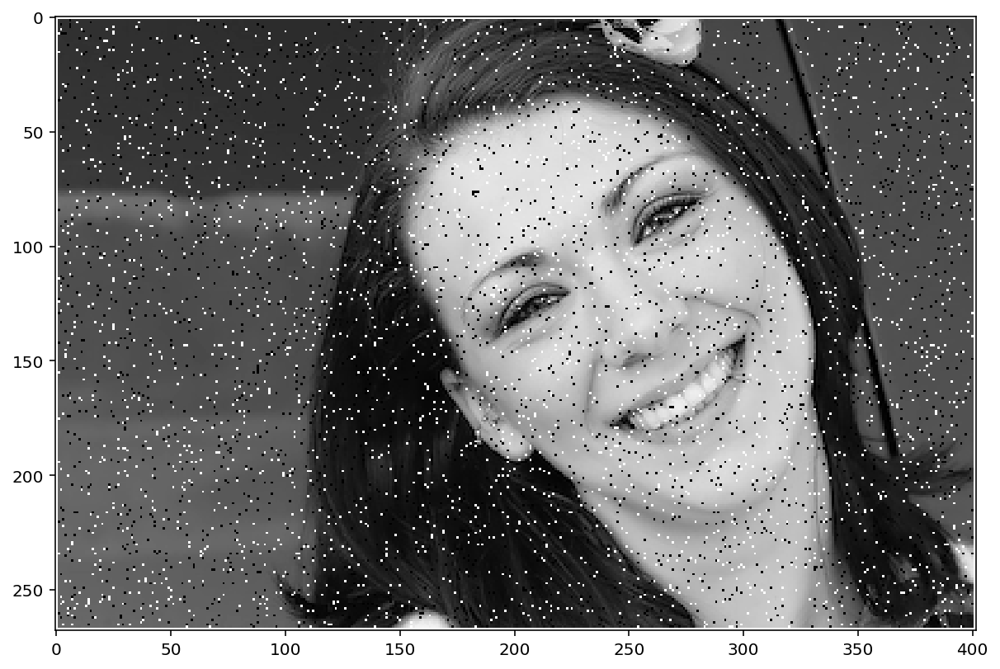

In [260]:
borderImpulseFace = addBorder(impulseFace,3//2)
showImage(borderImpulseFace)

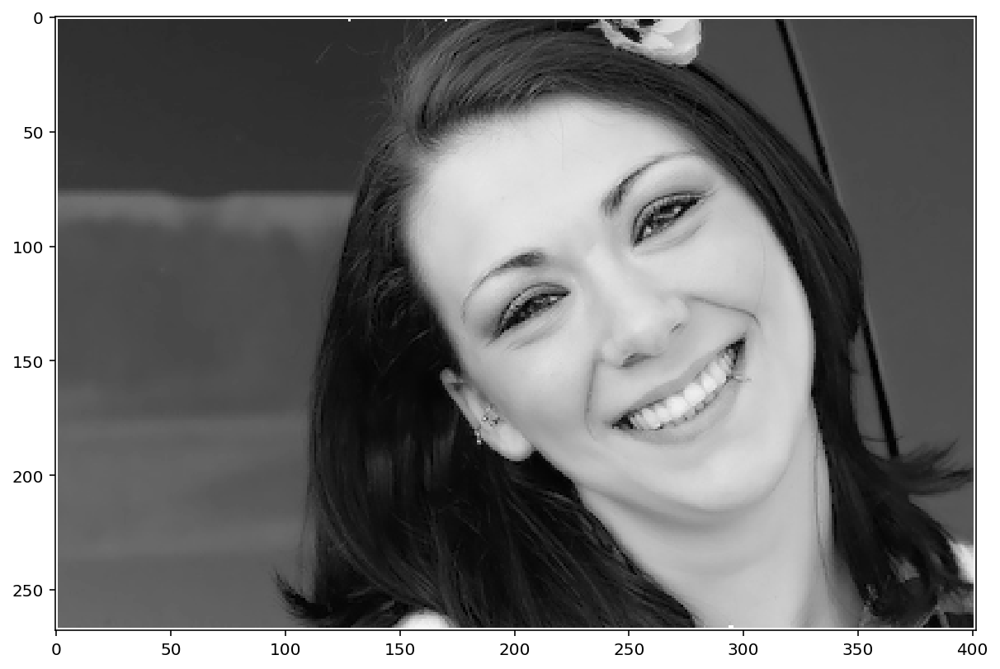

In [261]:
showImage(median_filter(borderImpulseFace,3))

As you can see, the clearness and sharpness of the original image has been restored. This shows that a median filter is a better method for reducing noise and restoring images to their original state versus mean filters.

## Adjusting the Kernel Size

We will now investigate the effect different kernel sizes have on image filtering. First we will start with images that have $5$% noise.

kernelSize = 3:

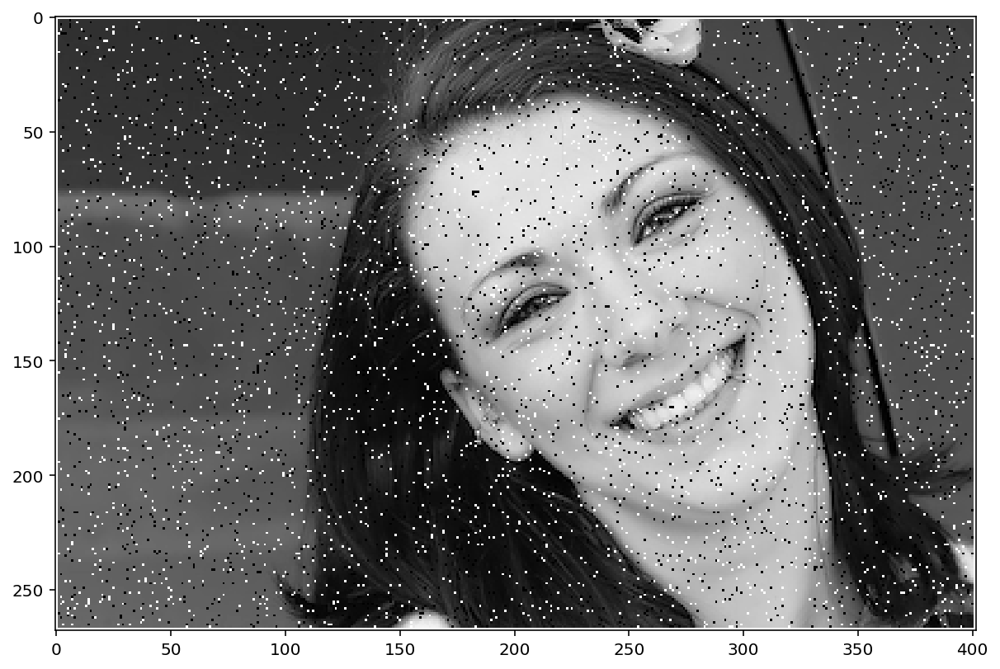

In [262]:
borderImpulseFace = addBorder(impulseFace,3//2)
showImage(borderImpulseFace)

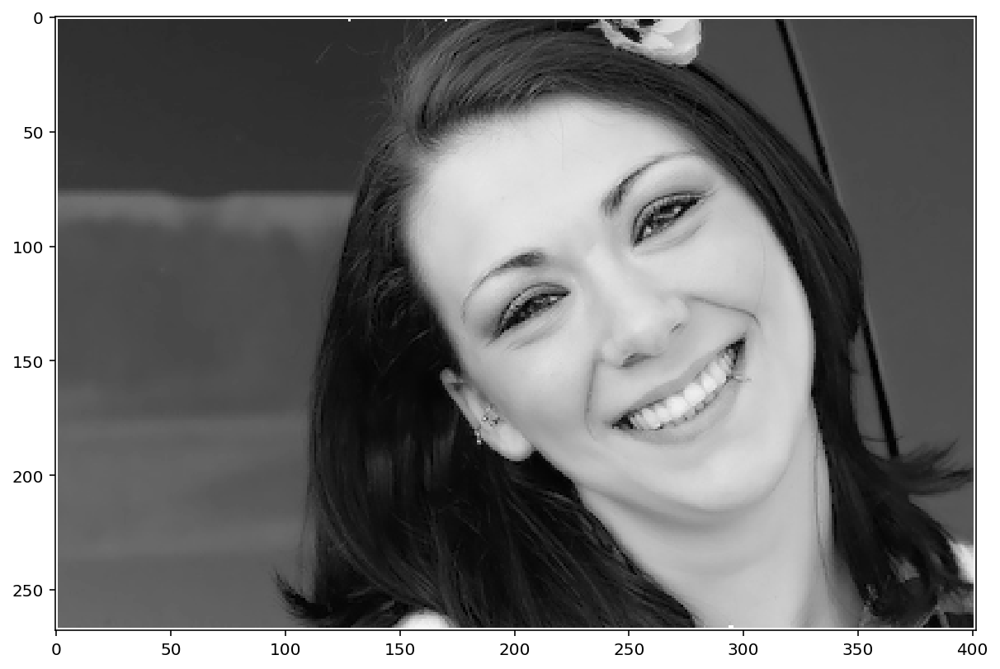

In [263]:
showImage(median_filter(borderImpulseFace,3))

kernelSize = 5:

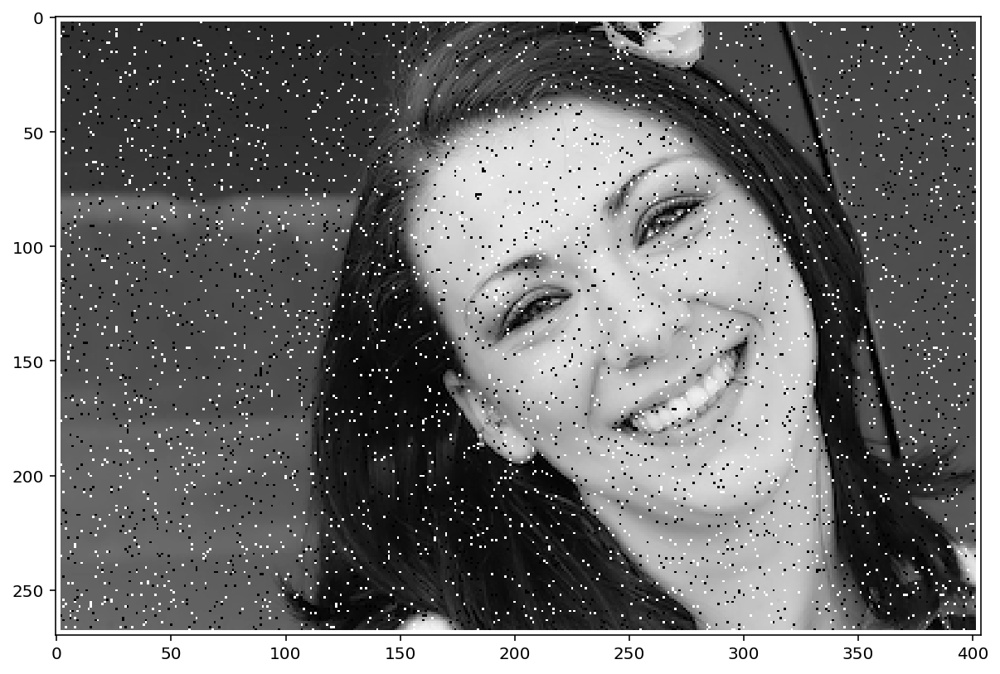

In [264]:
borderImpulseFace = addBorder(impulseFace,5//2)
showImage(borderImpulseFace)

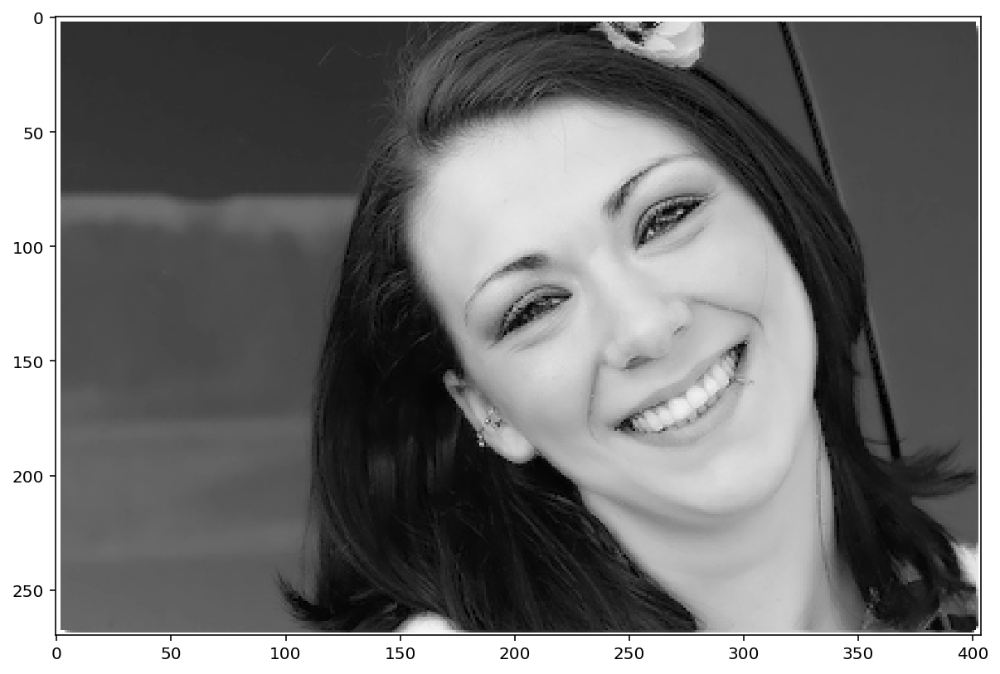

In [265]:
showImage(median_filter(borderImpulseFace,5))

kernelSize = 15:

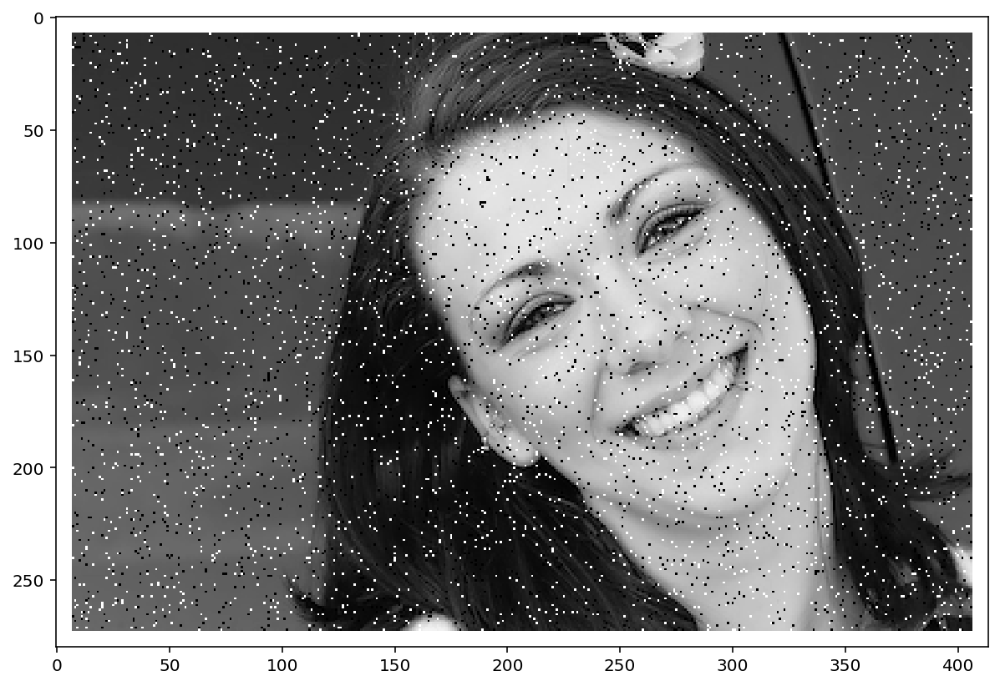

In [266]:
borderImpulseFace = addBorder(impulseFace,15//2)
showImage(borderImpulseFace)

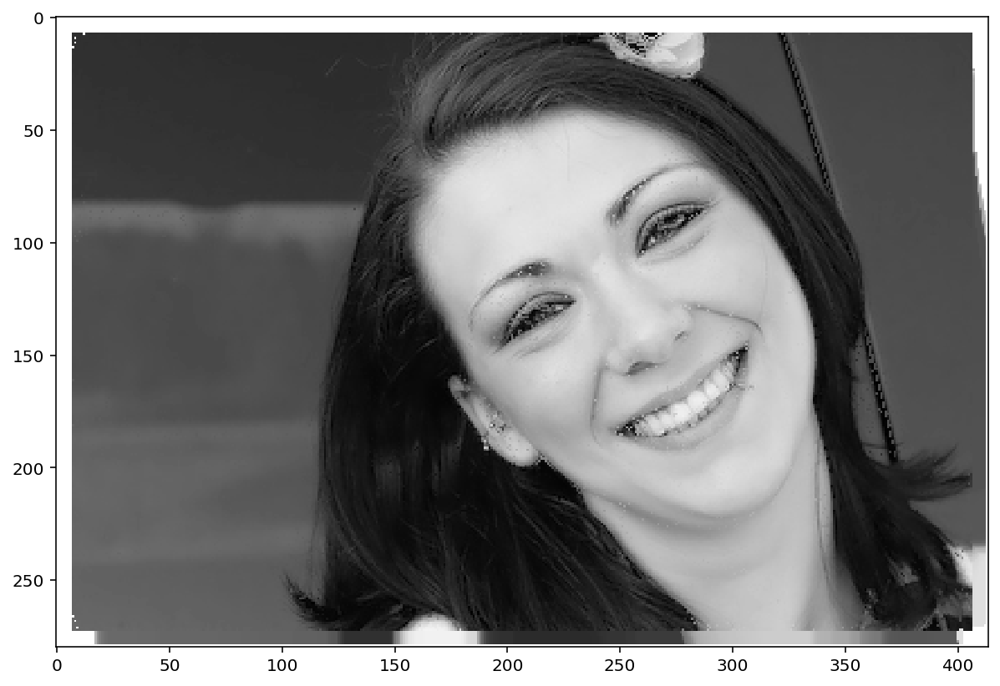

In [267]:
showImage(median_filter(borderImpulseFace,15))

With low levels of noise, a smaller kernel size is most effective at restoring the original image. We will now investigate differing kernel sizes with a much larger amount of noise added, in this case $30$%. The image is barely recognizeable in this state.

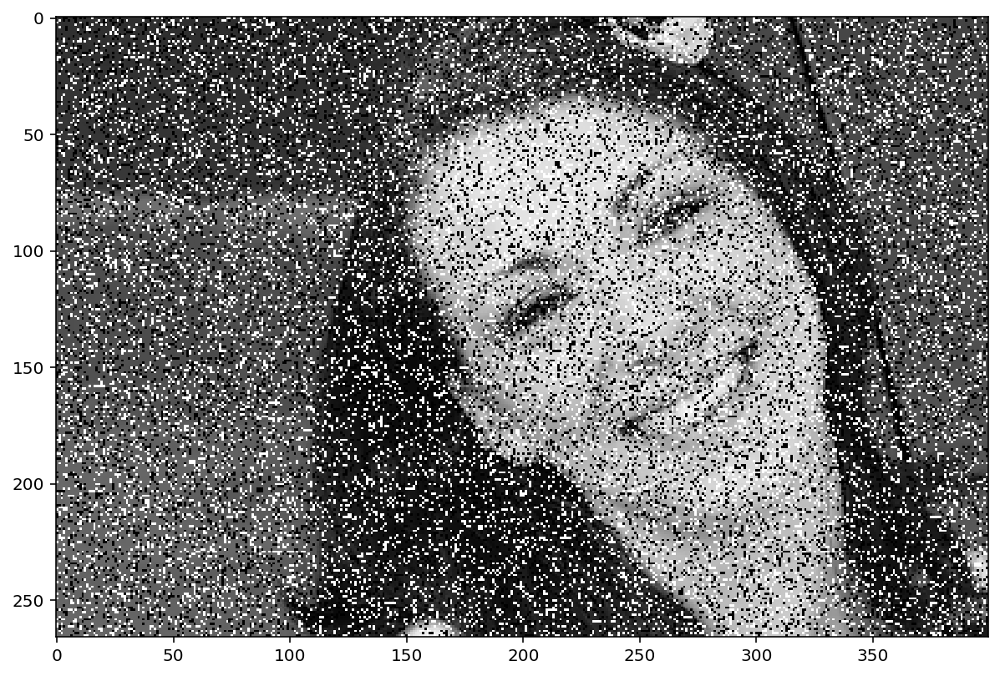

In [269]:
impulseFace = sp_noise(face,0.3)
showImage(impulseFace)

kernelSize = 3:

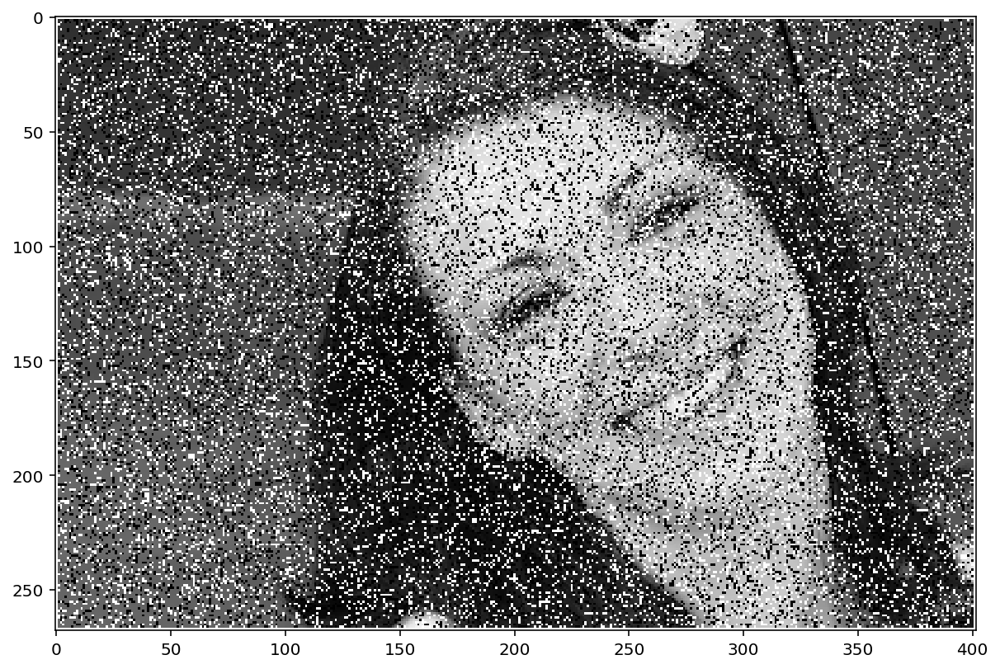

In [270]:
borderImpulseFace = addBorder(impulseFace,3//2)
showImage(borderImpulseFace)

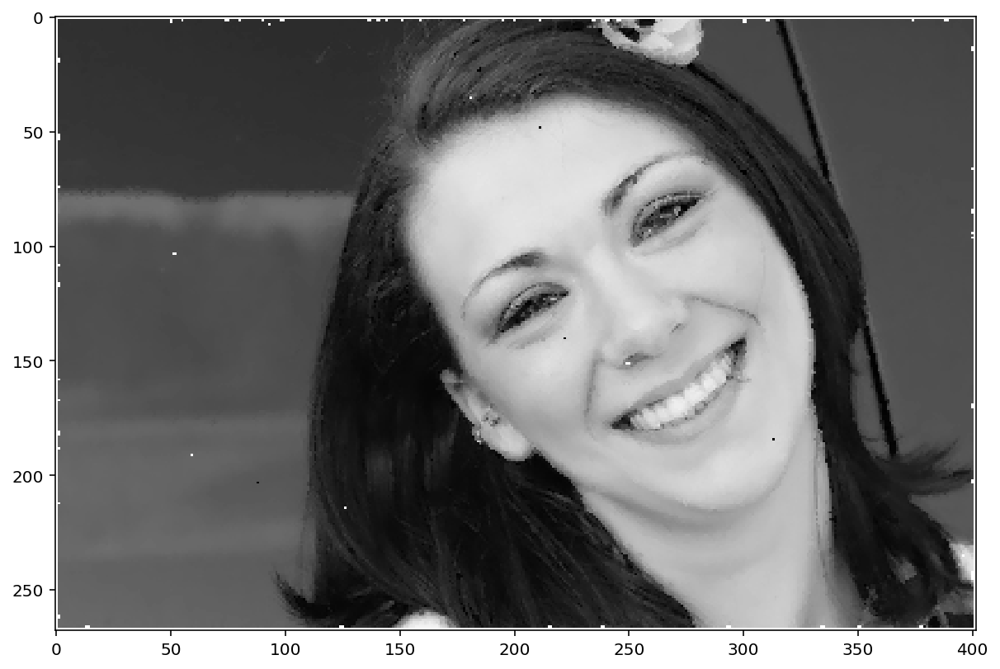

In [271]:
showImage(median_filter(borderImpulseFace,3))

kernelSize = 5:

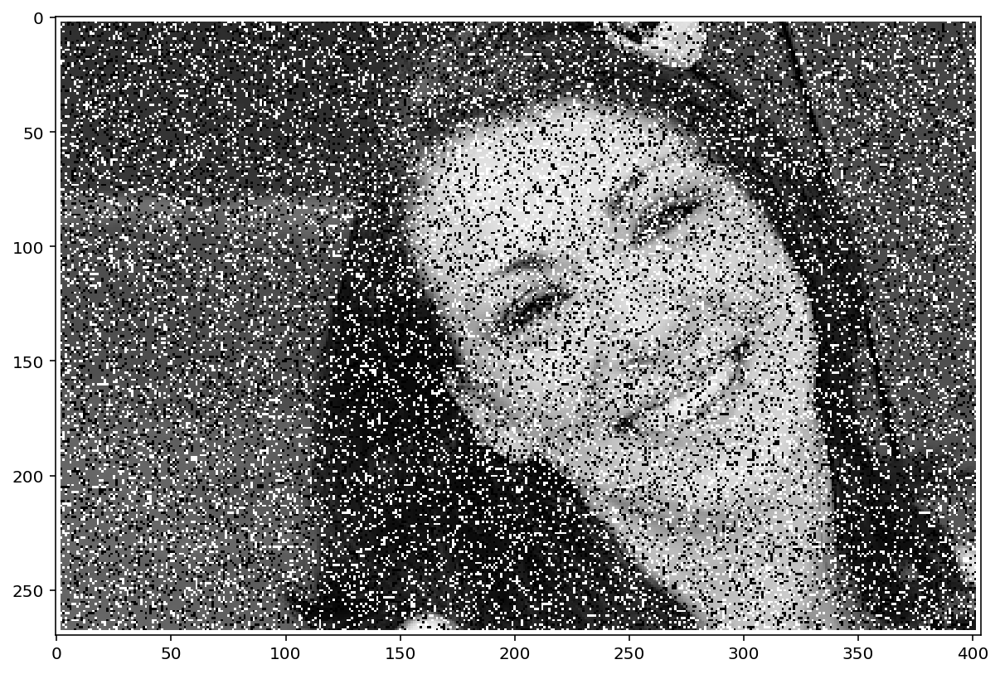

In [272]:
borderImpulseFace = addBorder(impulseFace,5//2)
showImage(borderImpulseFace)

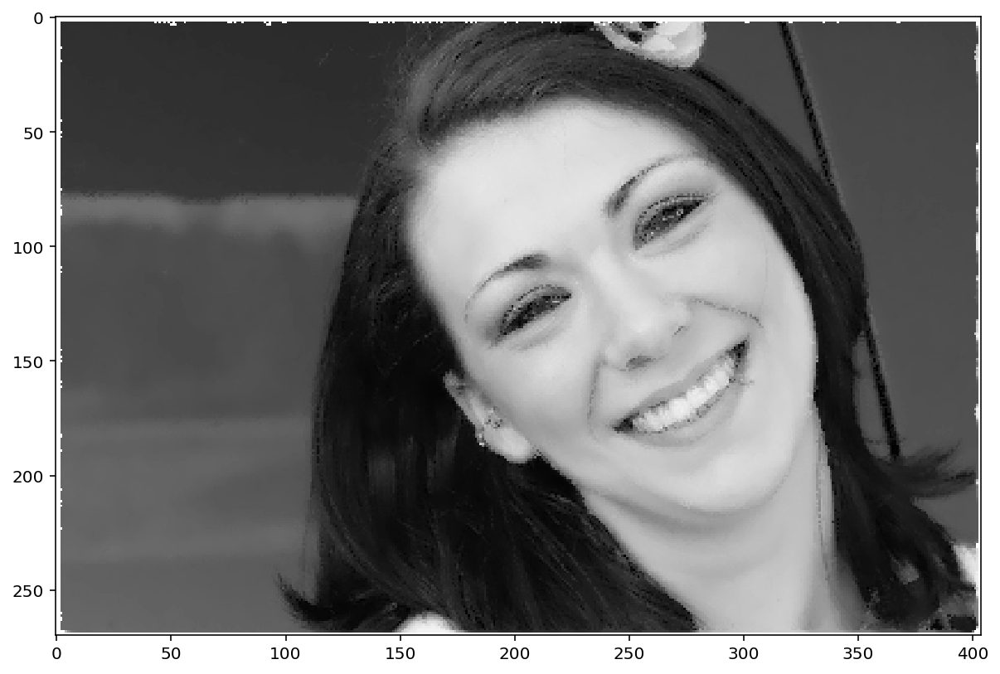

In [273]:
showImage(median_filter(borderImpulseFace,5))

kernelSize = 15:

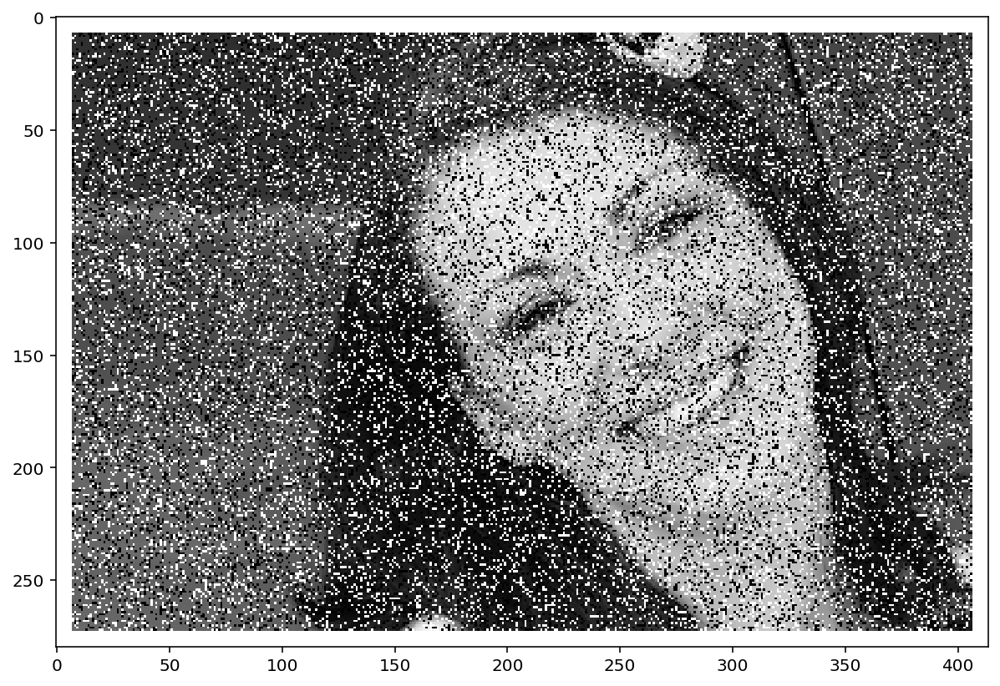

In [274]:
borderImpulseFace = addBorder(impulseFace,15//2)
showImage(borderImpulseFace)

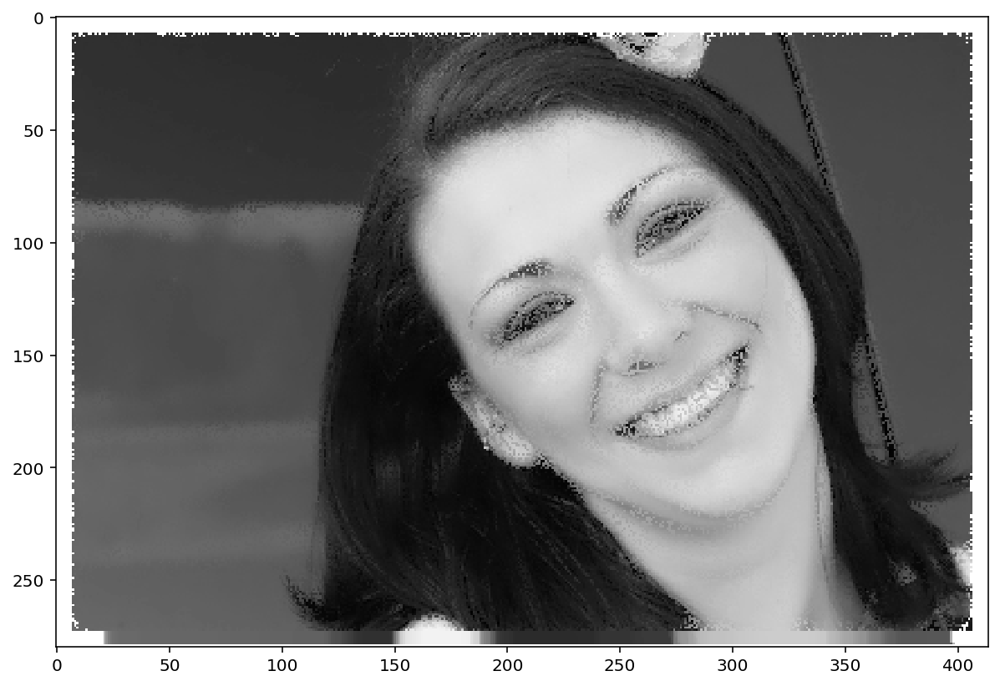

In [275]:
showImage(median_filter(borderImpulseFace,15))

At a large amount of noise added, a kernel size of $5$ was the best choice compared to larger/smaller kernel sizes. Now we will look at images that have an extreme level of distortion -- $80$%. At this level of distortion, the outline of the woman's face is barely visible.

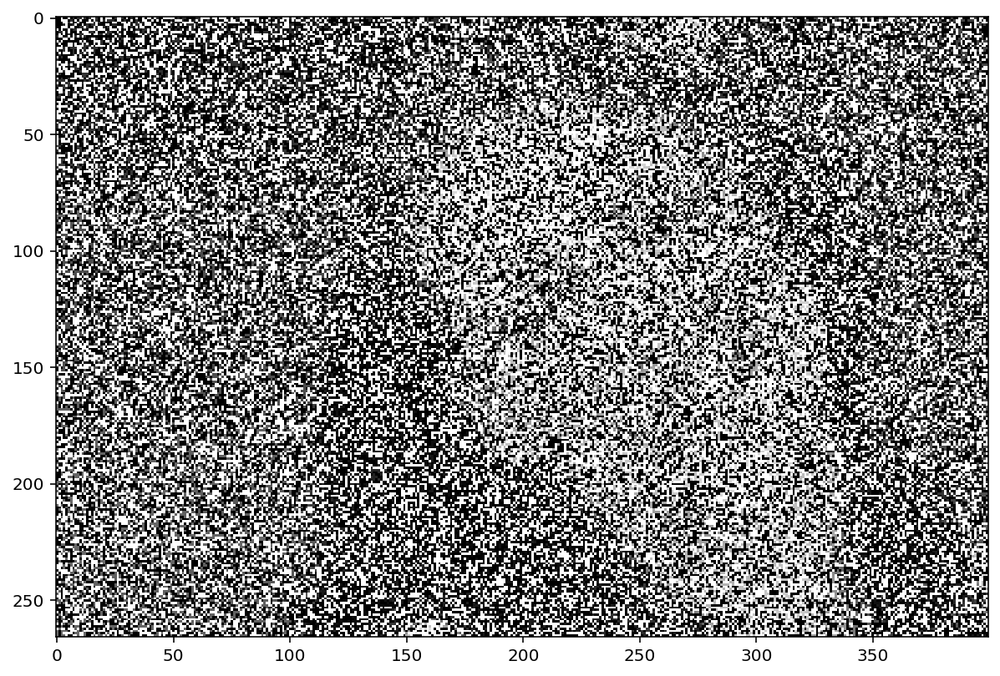

In [277]:
impulseFace = sp_noise(face,0.8)
showImage(impulseFace)

kernelSize = 3:

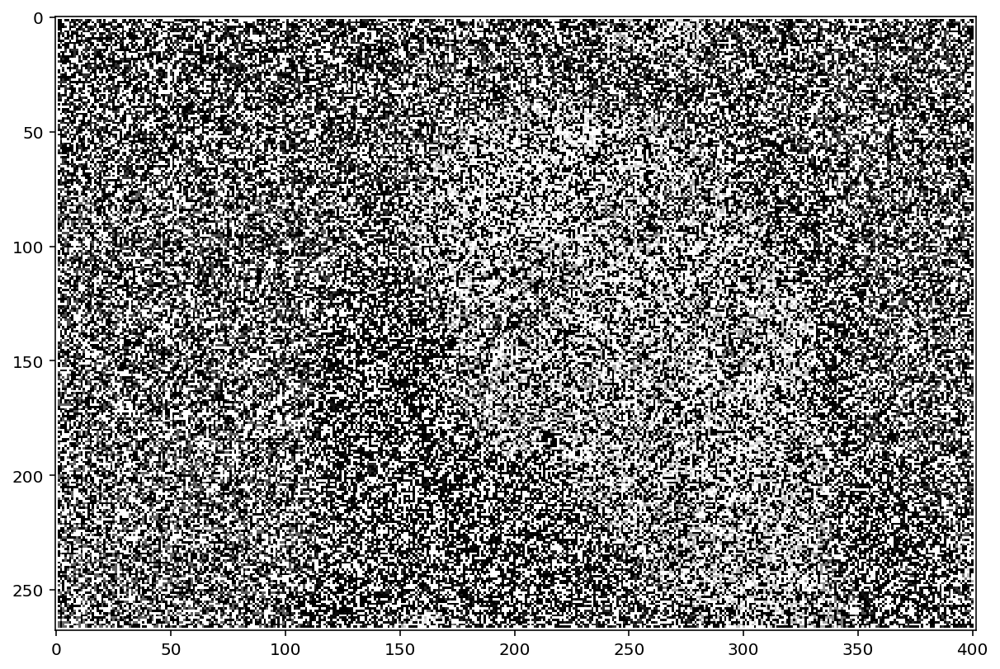

In [278]:
borderImpulseFace = addBorder(impulseFace,3//2)
showImage(borderImpulseFace)

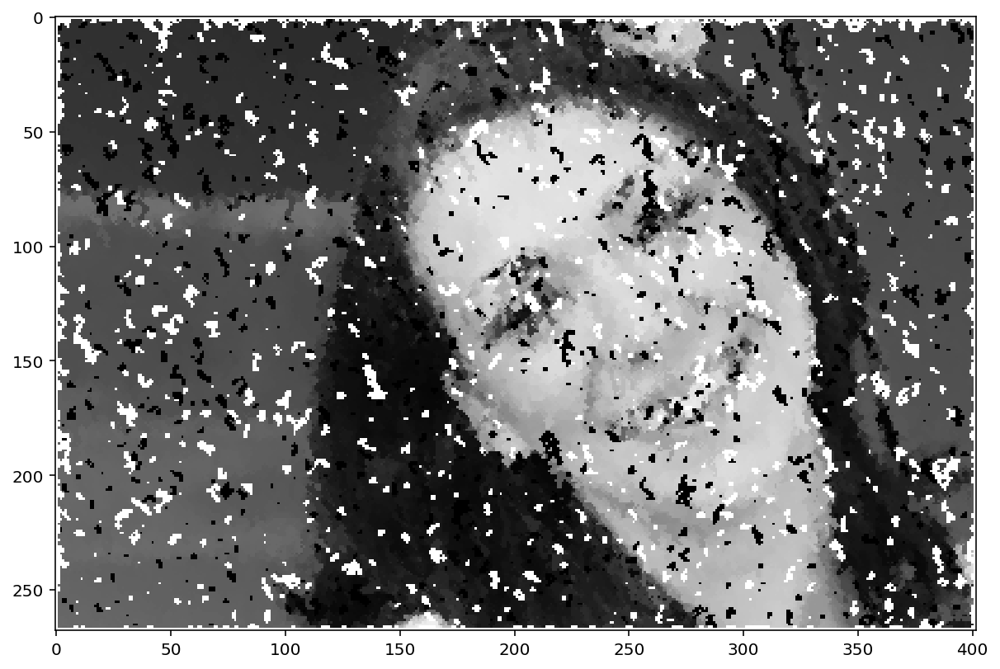

In [279]:
showImage(median_filter(borderImpulseFace,3))

kernelSize = 5:

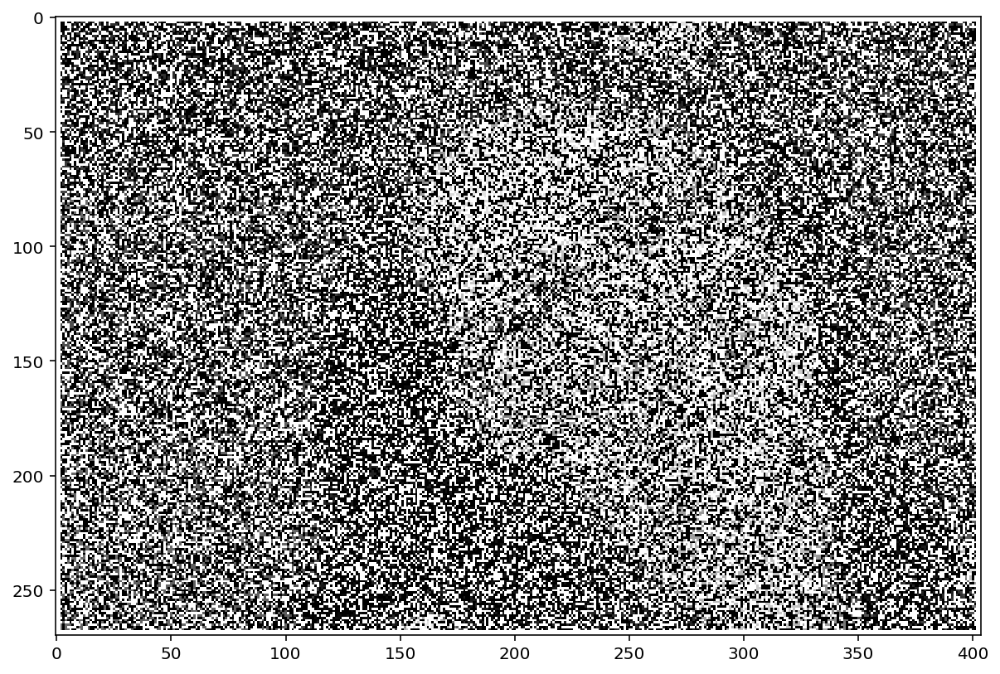

In [280]:
borderImpulseFace = addBorder(impulseFace,5//2)
showImage(borderImpulseFace)

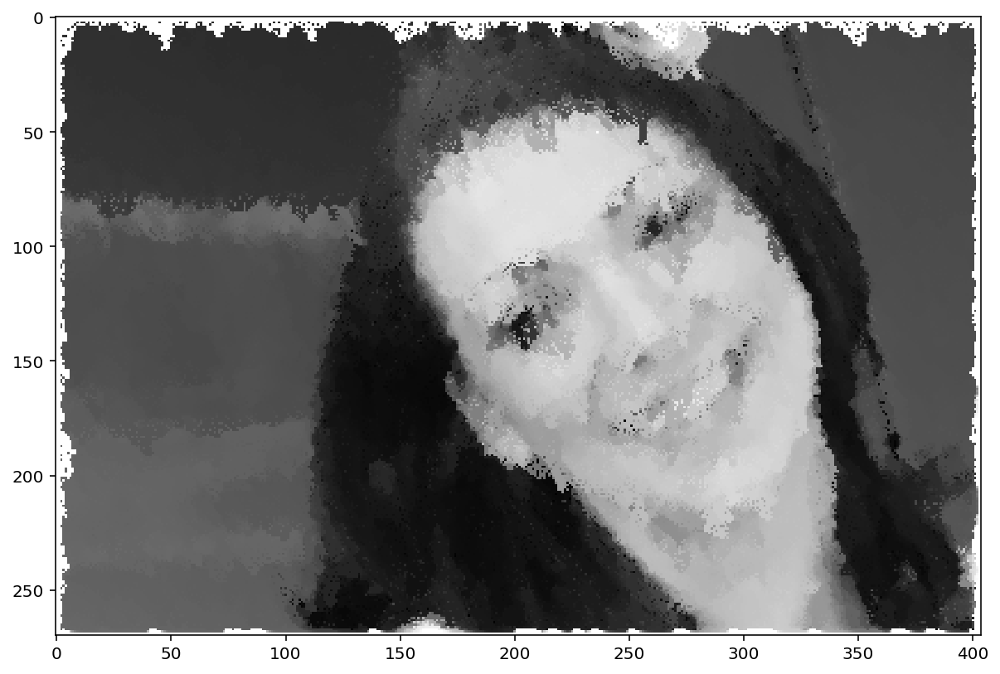

In [281]:
showImage(median_filter(borderImpulseFace,5))

kernelSize = 11:

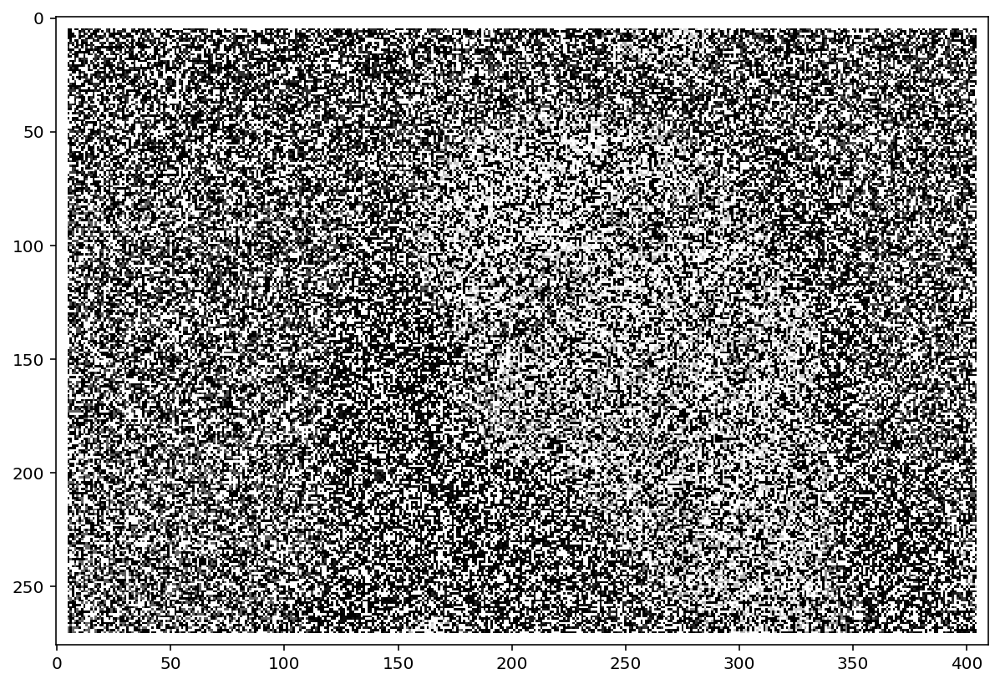

In [284]:
borderImpulseFace = addBorder(impulseFace,11//2)
showImage(borderImpulseFace)

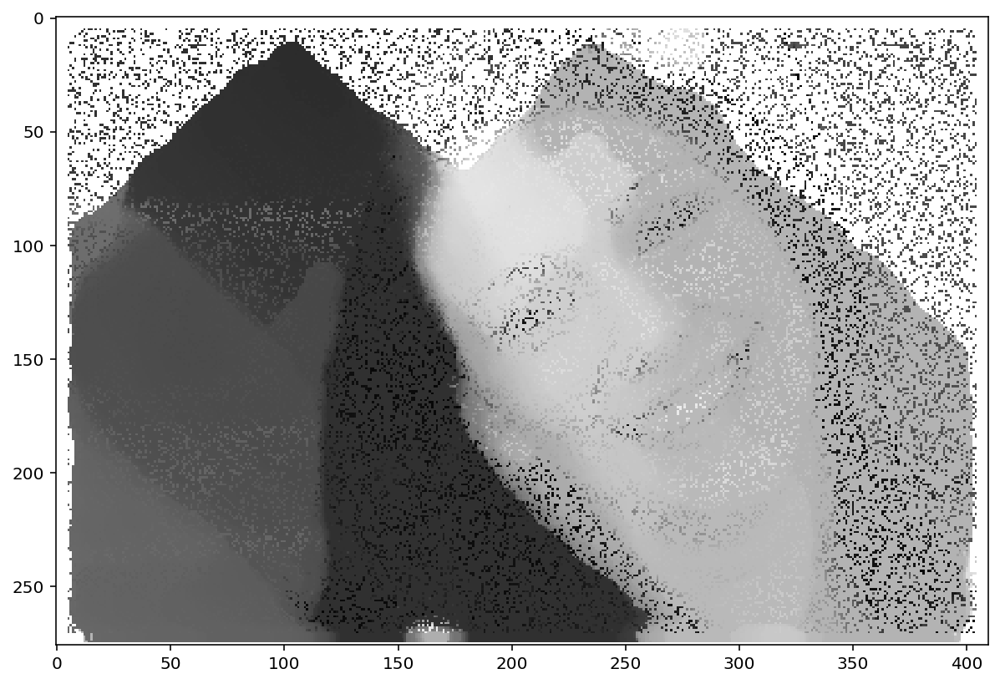

In [286]:
showImage(median_filter(borderImpulseFace,11))

At extreme levels of distortion, it is difficult to restore the image to its orginal state. A smaller kernel size helped to keep some of the original image sharpness, but was unable to remove a large portion of the salt and pepper noise. In comparison, a larger kernel size of $5$ was able to remove most of the salt and pepper noise, but was unable to restore the original images clearness and sharpness.

# Image Filtering -- Other Methods

Mean and median filters are not the only way to reduce noise in an image. We will now look at some other methods to reduce noise in an image. First we will try to implement a 'range' filter. The range of a set of data is the difference of the largest and smallest values in the data set. This is what the center square pixel will be calculated as.

In [287]:
def range_filter(image=np.ndarray,kernelSize=float):
    min = kernelSize//2
    max = math.ceil(kernelSize/2)
    for i in range(min,image.shape[0]-1):
        for j in range(min,image.shape[1]-1):
            square=np.array(image[i-min:i+max,j-min:j+max])
            if(square[min,min]==1 or square[min,min]==0):
                square[min][min]=(np.max(square) - np.min(square))
                image[i-min:i+max,j-min:j+max] = square
                
    return image

First we will look at an image with $5$% noise.

kernelSize = 3:

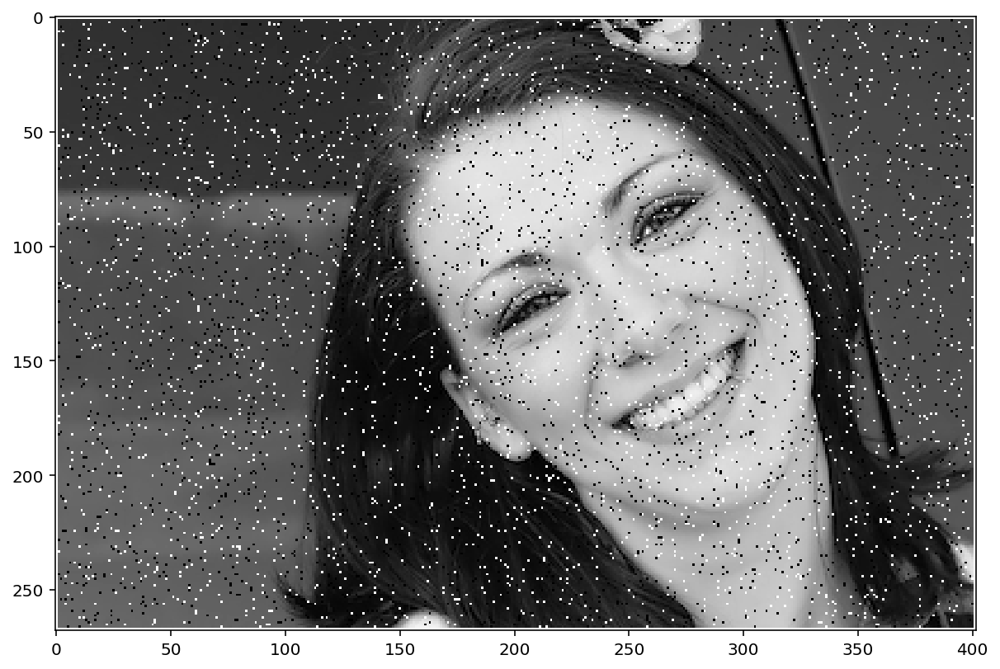

In [292]:
borderImpulseFace = addBorder(impulseFace,3//2)
showImage(borderImpulseFace)

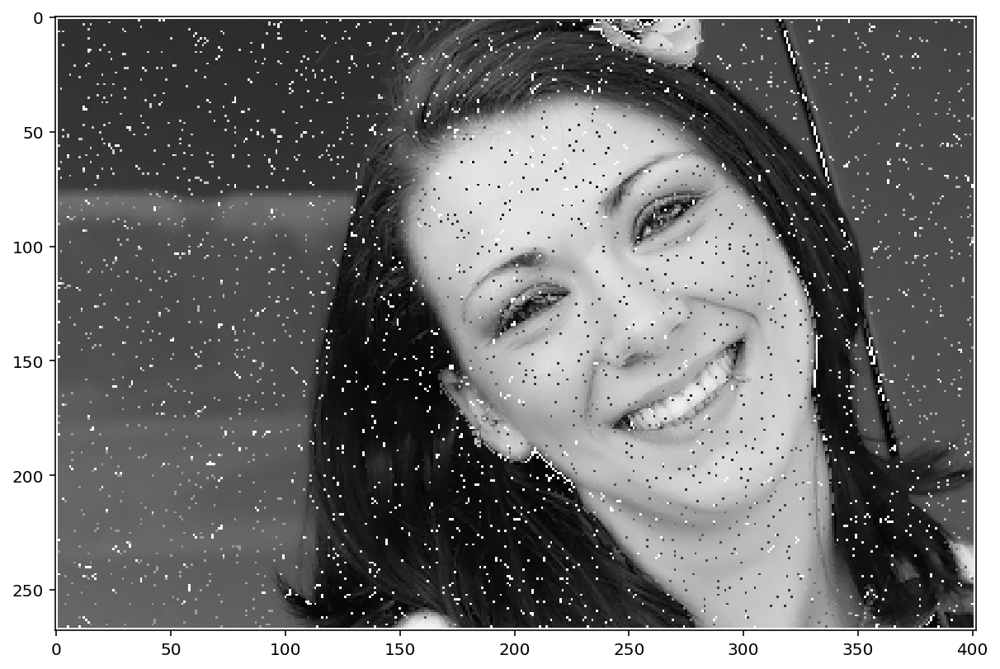

In [293]:
showImage(range_filter(borderImpulseFace,3))

kernelSize = 11:

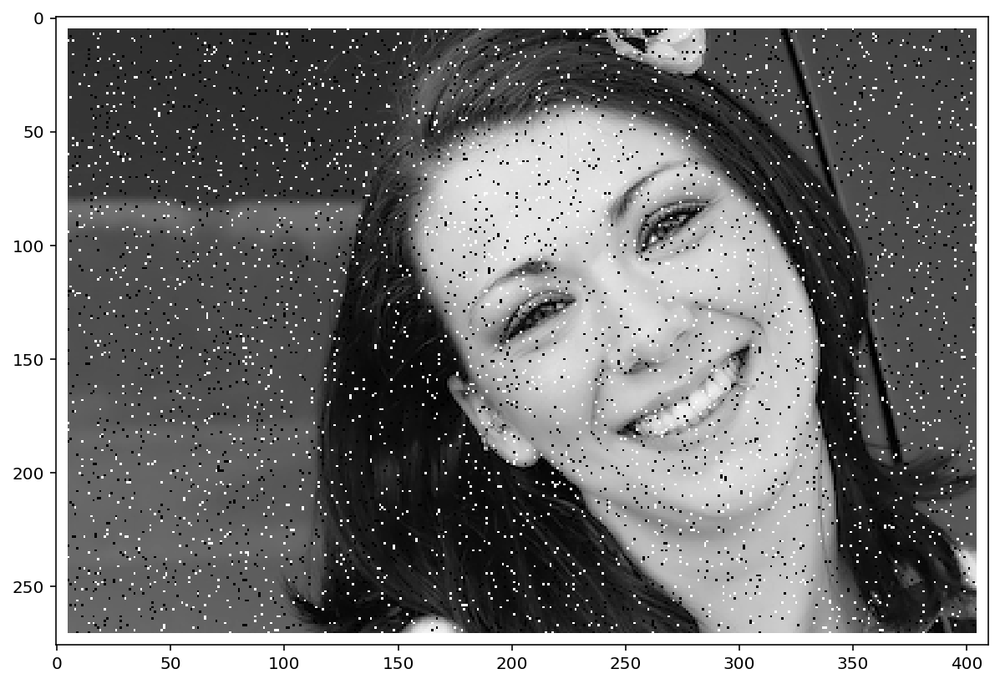

In [294]:
borderImpulseFace = addBorder(impulseFace,11//2)
showImage(borderImpulseFace)

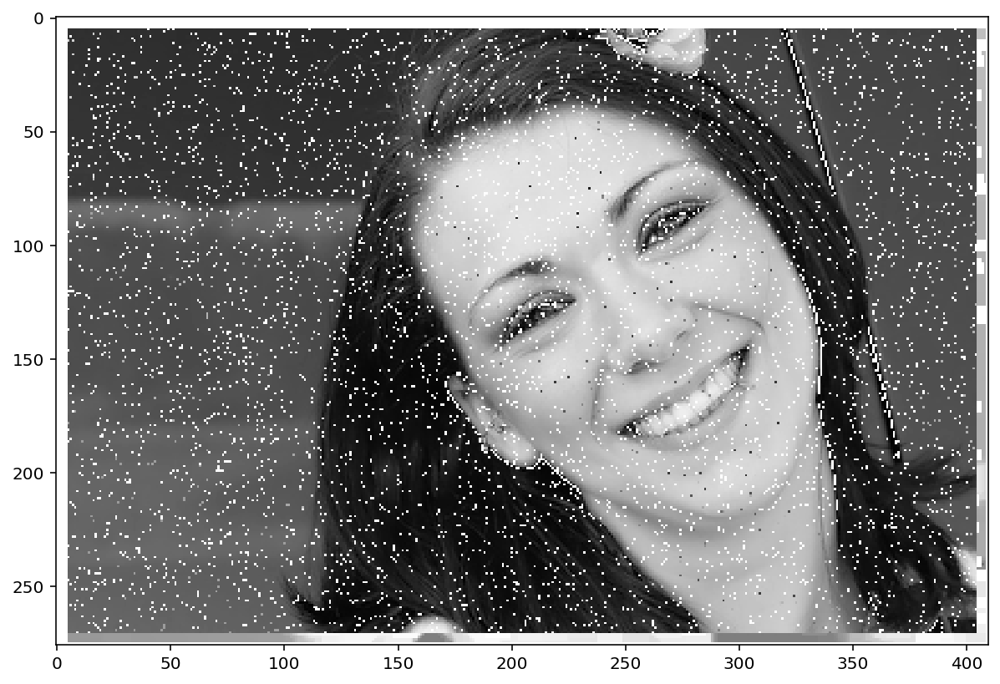

In [295]:
showImage(range_filter(borderImpulseFace,11))

Images with $30$% noise:

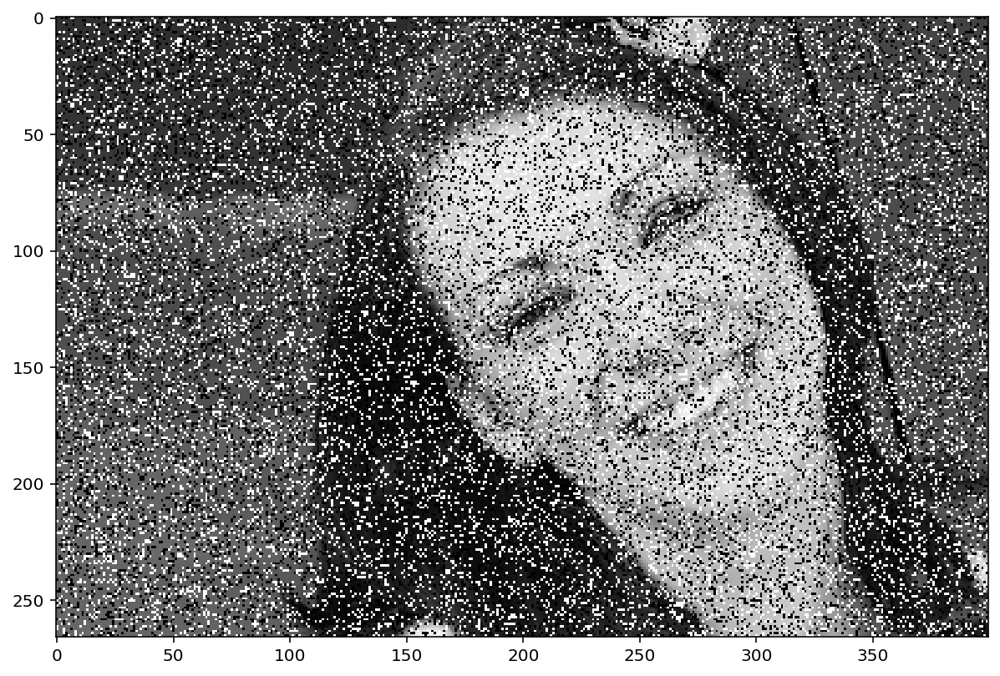

In [296]:
impulseFace = sp_noise(face,0.3)
showImage(impulseFace)

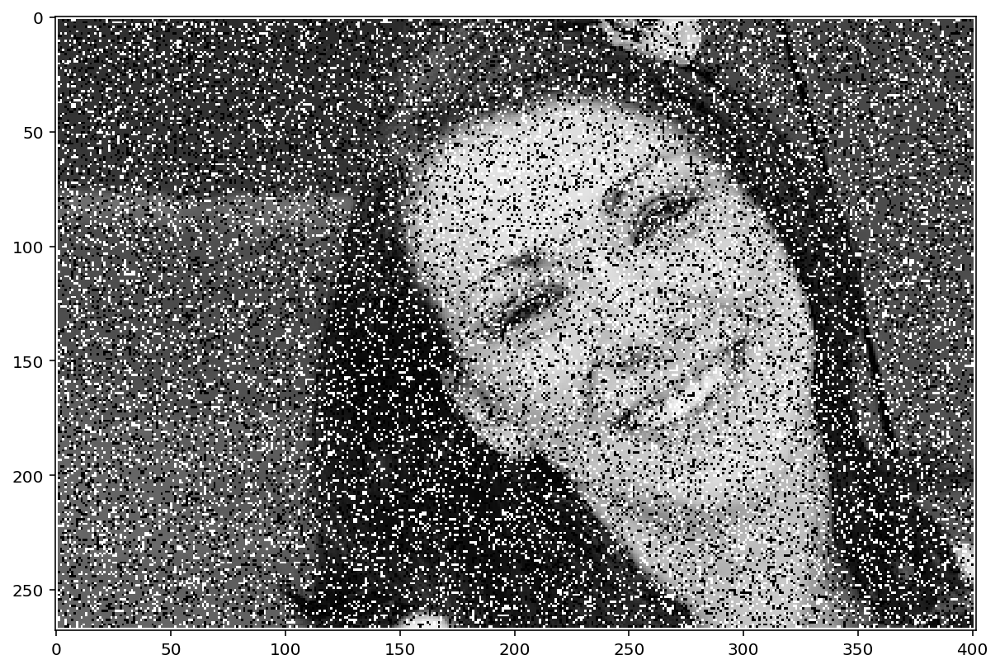

In [297]:
borderImpulseFace = addBorder(impulseFace,3//2)
showImage(borderImpulseFace)

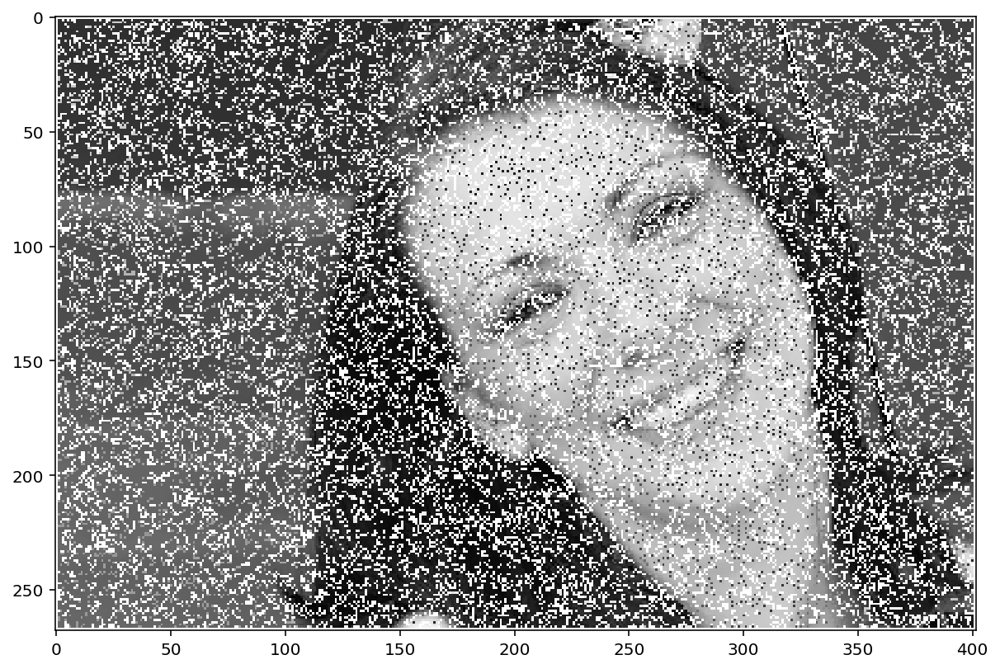

In [298]:
showImage(range_filter(borderImpulseFace,3))

As you can see the range_filter does a poor job of restoring images. One interesting effect of the range filter is that it does a good job of reducing the 'pepper' noise in the image, but leaves most of the 'salt' noise intact.

The next method we will try is to add the minimum and maximum values of the data set and divide by $2$. This resulting answer will be the value of the center pixel.

In [299]:
def minMaxAvg_filter(image=np.ndarray,kernelSize=float):
    min = kernelSize//2
    max = math.ceil(kernelSize/2)
    for i in range(min,image.shape[0]-1):
        for j in range(min,image.shape[1]-1):
            square=np.array(image[i-min:i+max,j-min:j+max])
            if(square[min,min]==1 or square[min,min]==0):
                square[min][min]=((np.max(square) + np.min(square))/2)
                image[i-min:i+max,j-min:j+max] = square
                
    return image

Image Noise = $5$%:

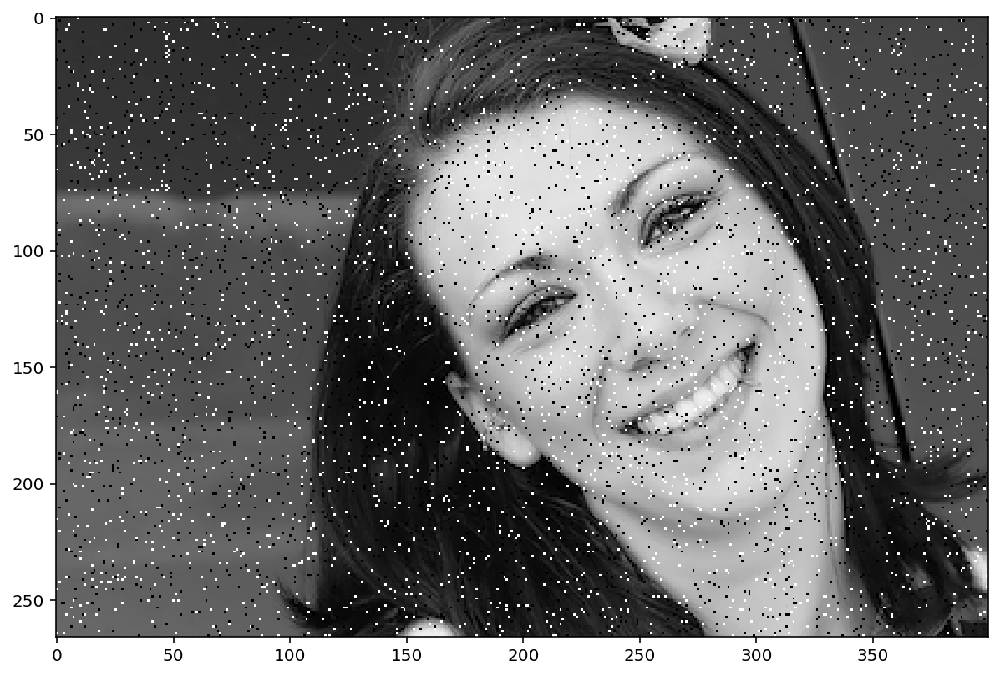

In [300]:
impulseFace = sp_noise(face,0.05)
showImage(impulseFace)

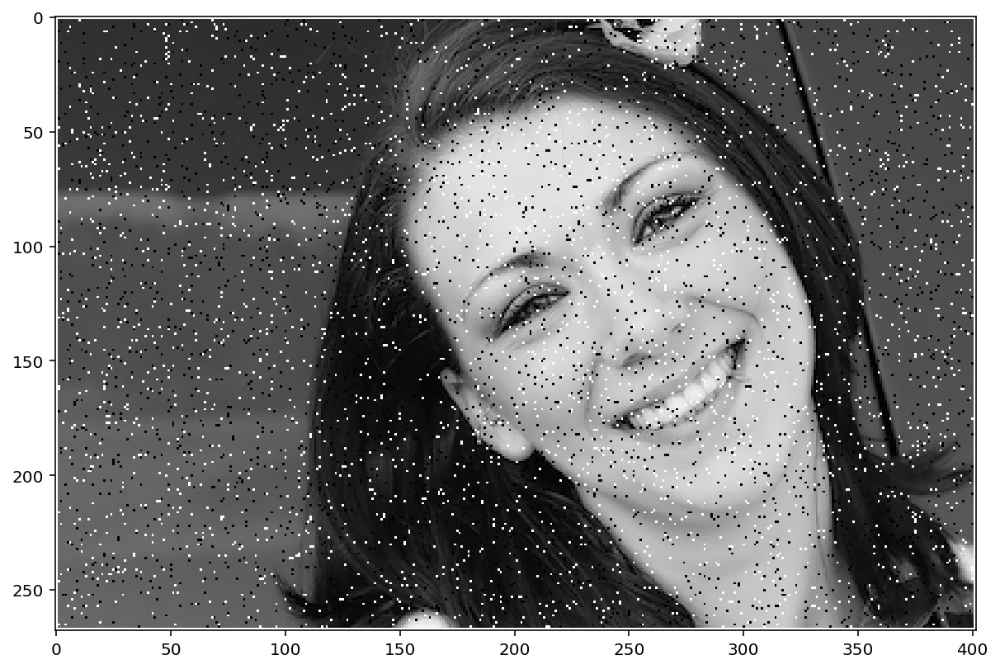

In [301]:
borderImpulseFace = addBorder(impulseFace,3//2)
showImage(borderImpulseFace)

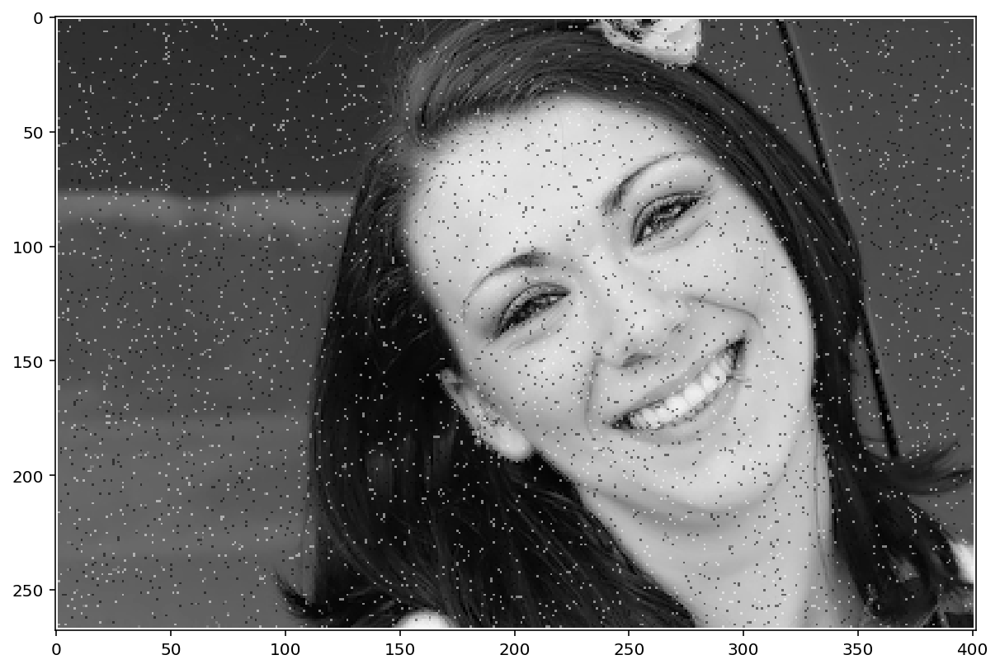

In [302]:
showImage(minMaxAvg_filter(borderImpulseFace,3))

Image Noise = $30$%:

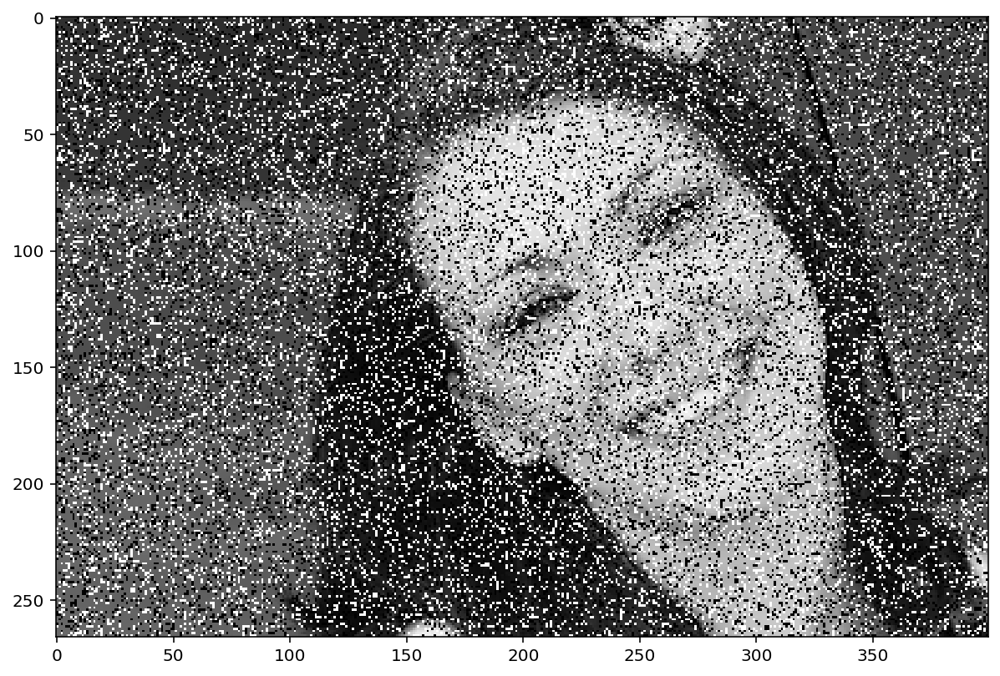

In [303]:
impulseFace = sp_noise(face,0.3)
showImage(impulseFace)

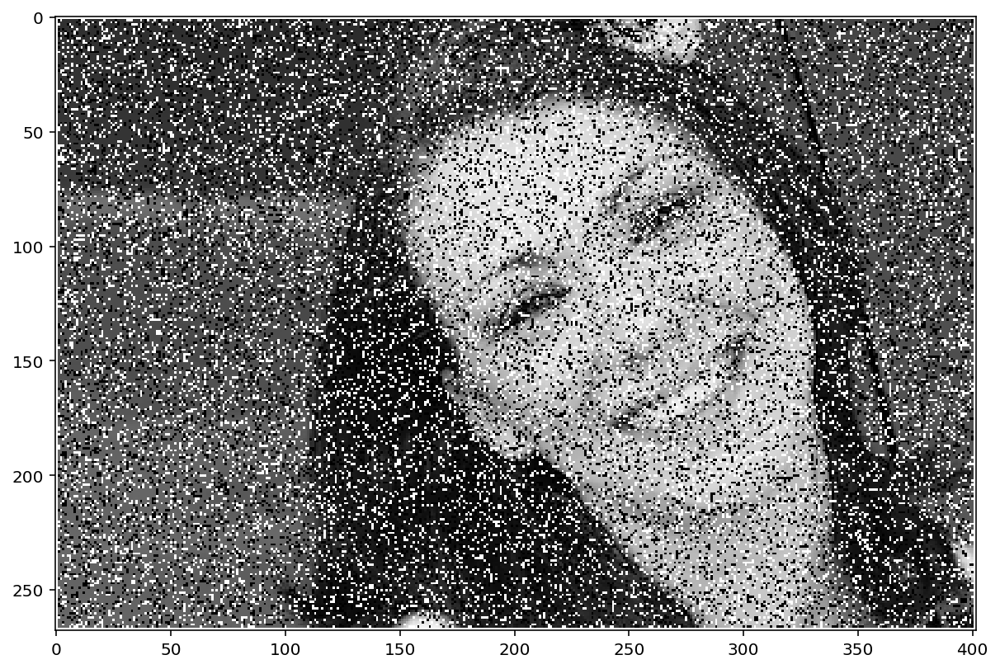

In [304]:
borderImpulseFace = addBorder(impulseFace,3//2)
showImage(borderImpulseFace)

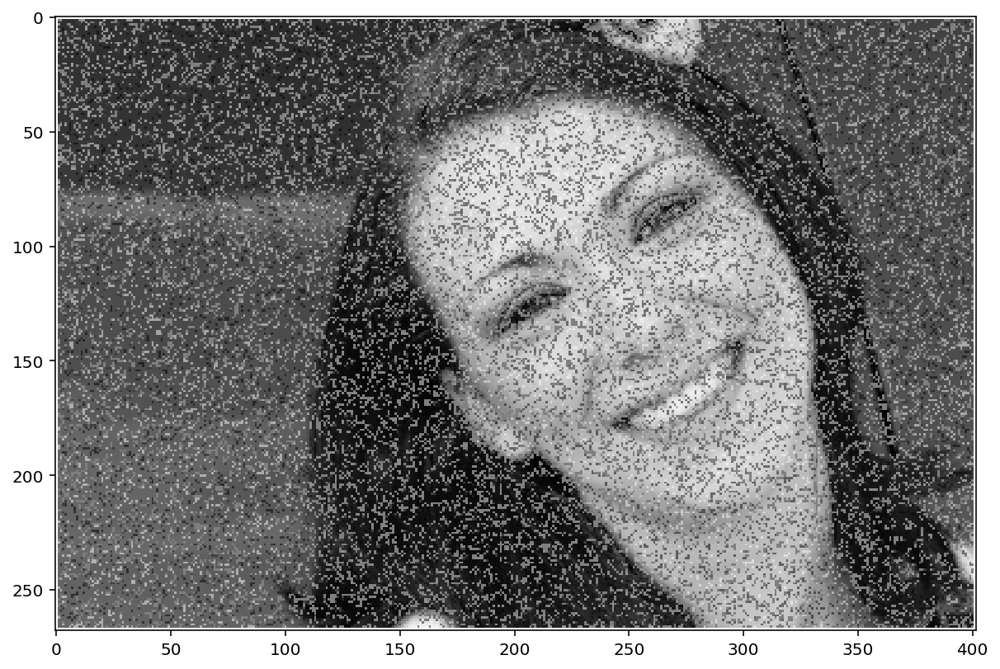

In [305]:
showImage(minMaxAvg_filter(borderImpulseFace,3))

kernelSize = 7:

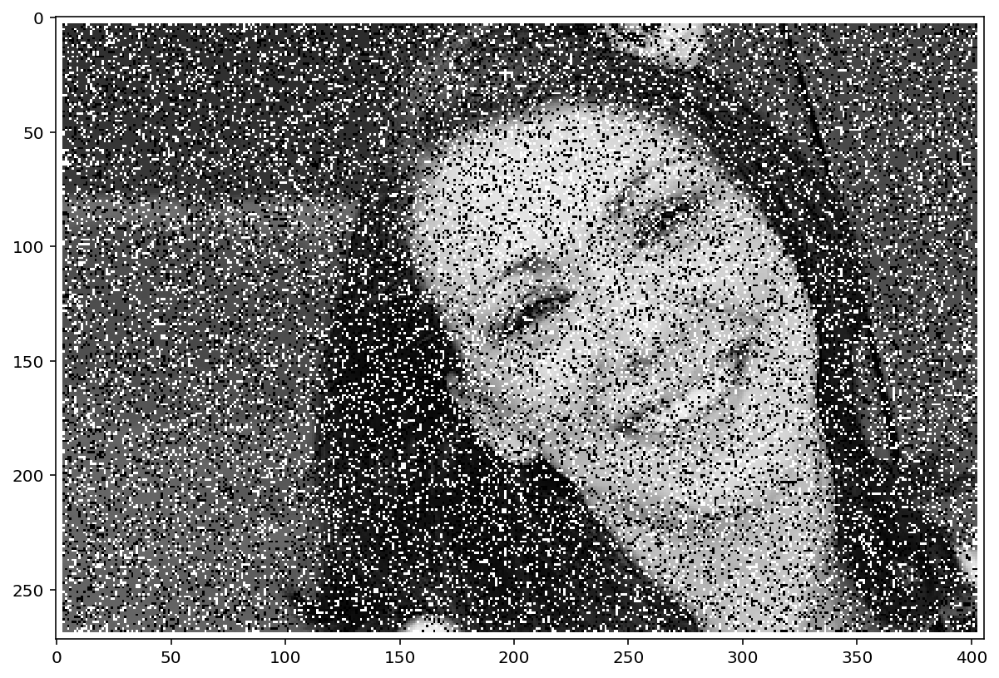

In [306]:
borderImpulseFace = addBorder(impulseFace,7//2)
showImage(borderImpulseFace)

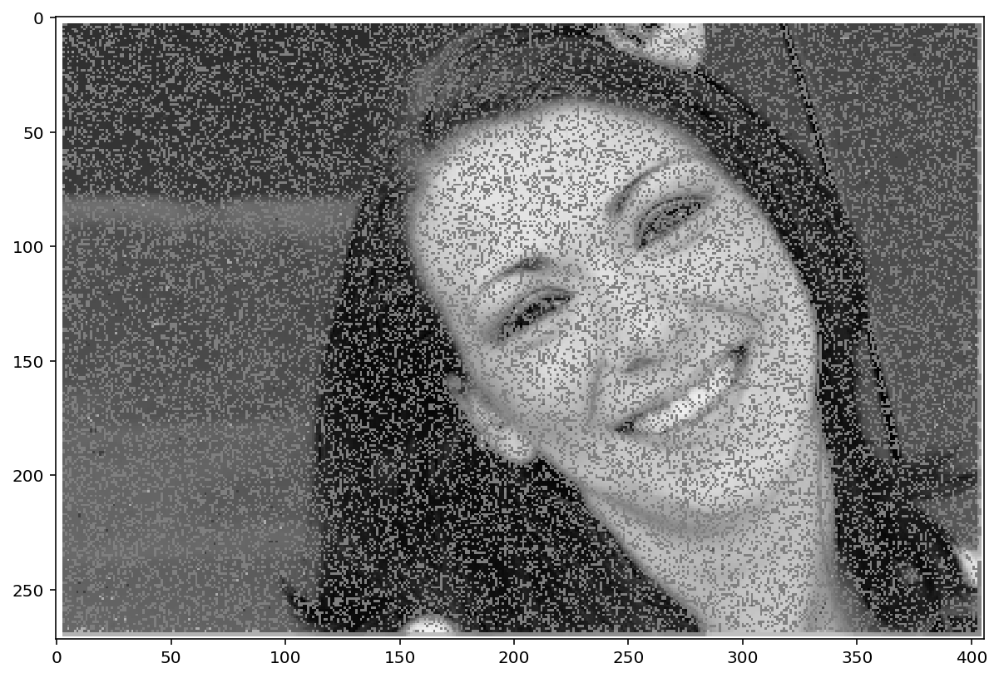

In [307]:
showImage(minMaxAvg_filter(borderImpulseFace,7))

The `minMaxAvg_filter()` did help to partially restore the image. While it doesn't remove the salt and pepper noise, it did reduce it to more neutral colors and made the image easier to read. With a larger kernel size, this filter produced even better results with heavily noised images.

# Conclusion

Image filtering is a very real world problem that is difficult to tackle. With the popularity of social media platforms where users constantly share images, crime scene investigations and many other instances, it is imperative that clean and sharp images are used. A form of noise that is seen from time to time is salt and pepper noise, otherwise known as impulse noise. This is noise where there are spikes in the image signal, causing white and black sports to appear randomly throughout the image.<br>
The best method to rid an image of impulse noise is median filtering, which works by iteratively traversing the rows and columns of the image data and selecting a n x n (kernel size) square of pixels, and then setting the middle pixel equal to the median value of all of the pixels in the square. We saw that with images containing lower levels of noise, a small kernel size was most effective. But with heavily noised images, a slightly larger kernel size was more effective at reducing the salt and pepper noise.<br>
The median filter was shown to be the most effective filter, but other methods such as the (min + max)/2 filter was shown to be able to reduce the noise in the image, and make the resulting image somewhat readable compared to its initial state.

# Extra Credit

In [308]:
ub1 = plt.imread('ub_noisy1.png')
ub2 = plt.imread('ub_noisy2.png')
ub3 = plt.imread('ub_noisy3.png')
ub4 = plt.imread('ub_noisy4.png')

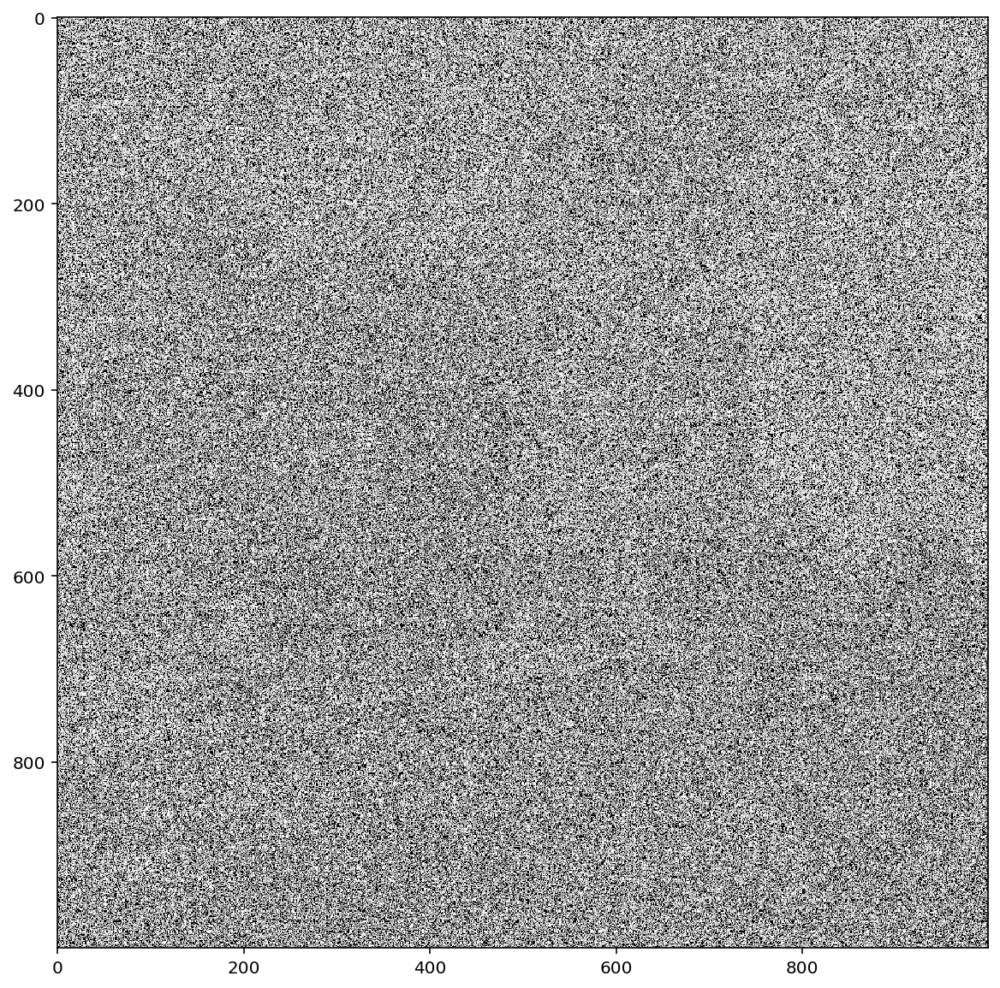

In [309]:
showImage(ub1)

In [310]:
ub1 = ub1[:,:,0]

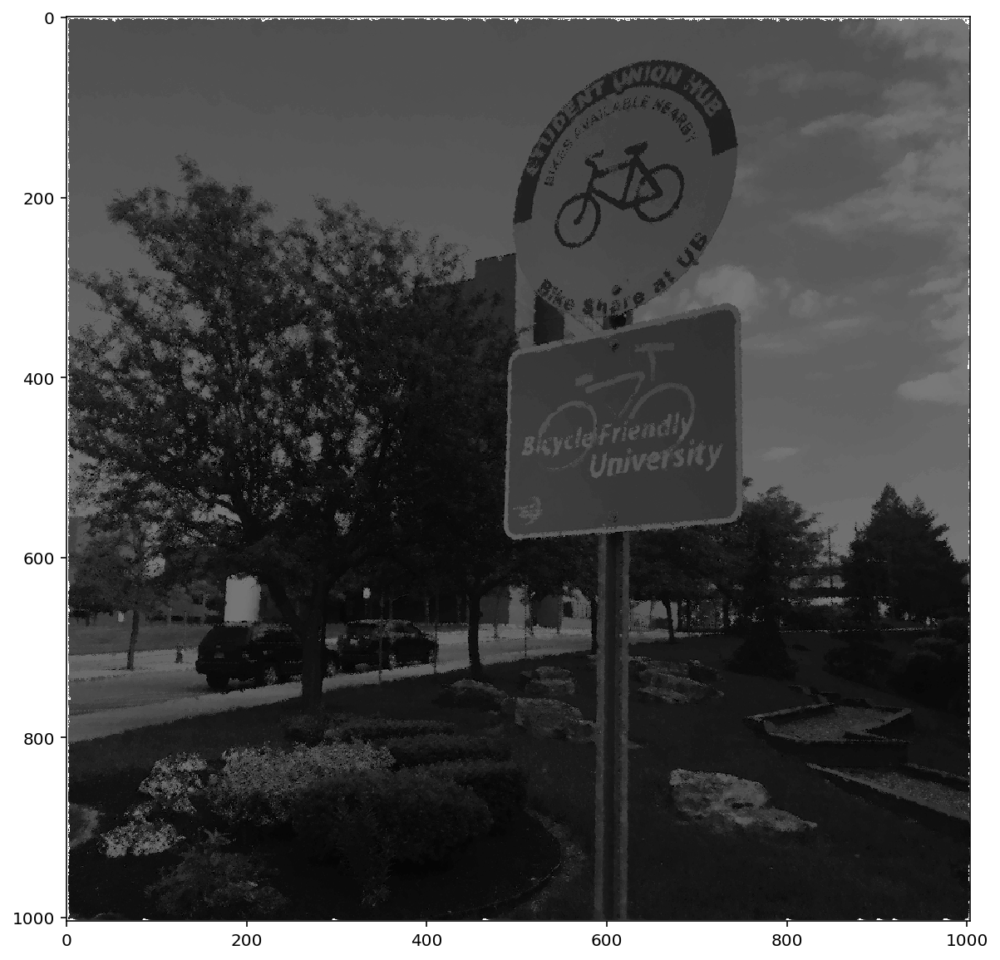

In [311]:
filter1 = addBorder(ub1,5//2)
showImage(median_filter(filter1,5))

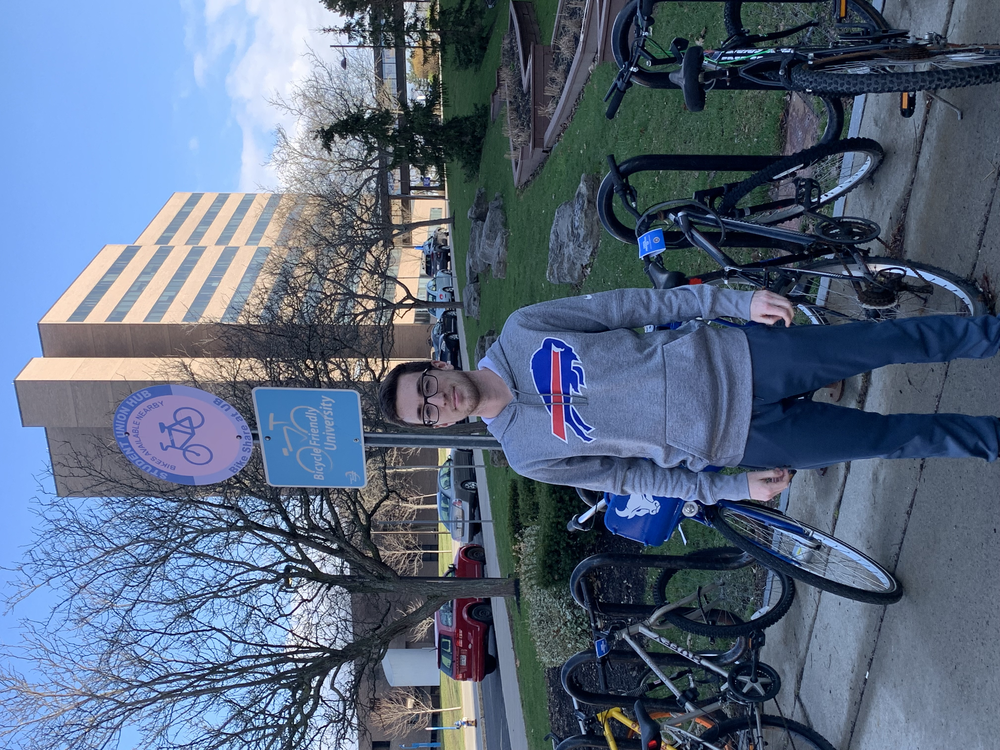

In [312]:
from IPython.display import Image
Image('nc1.jpeg')

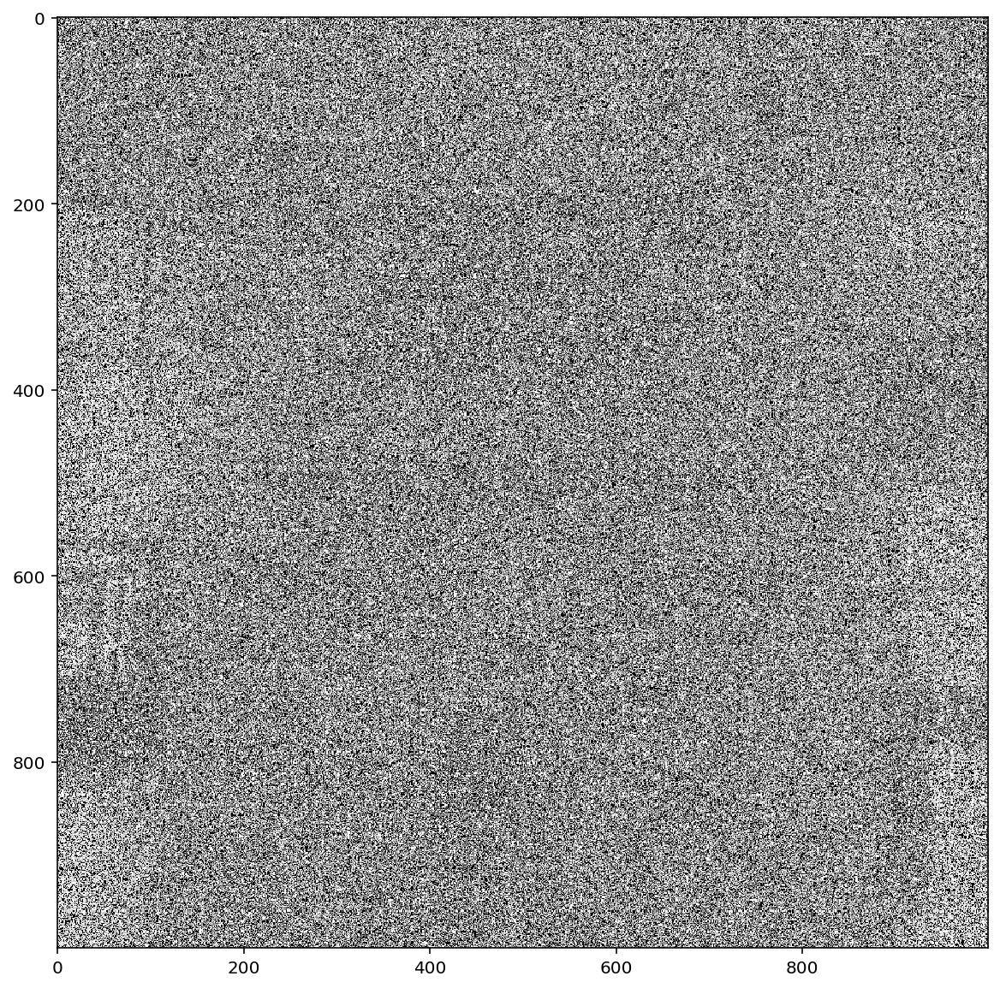

In [313]:
showImage(ub2)

In [314]:
ub2 = ub2[:,:,0]

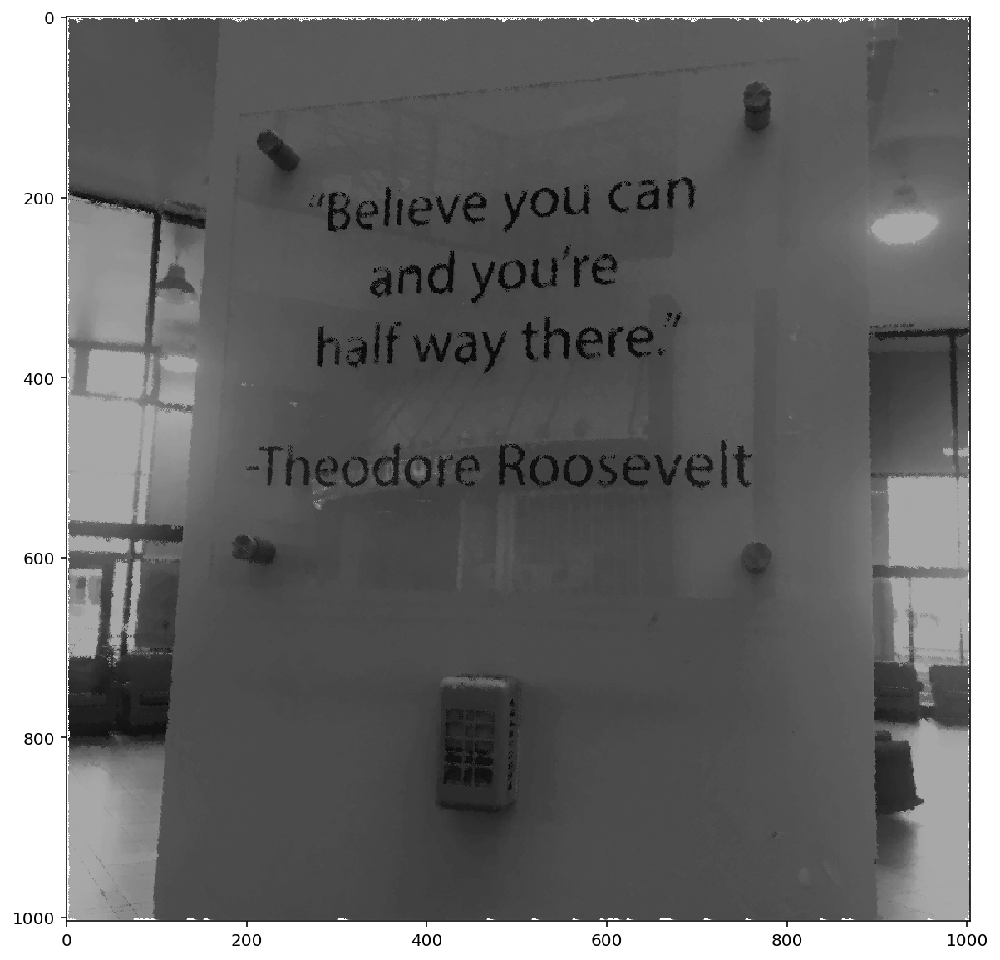

In [315]:
filter2 = addBorder(ub2,5//2)
showImage(median_filter(filter2,5))

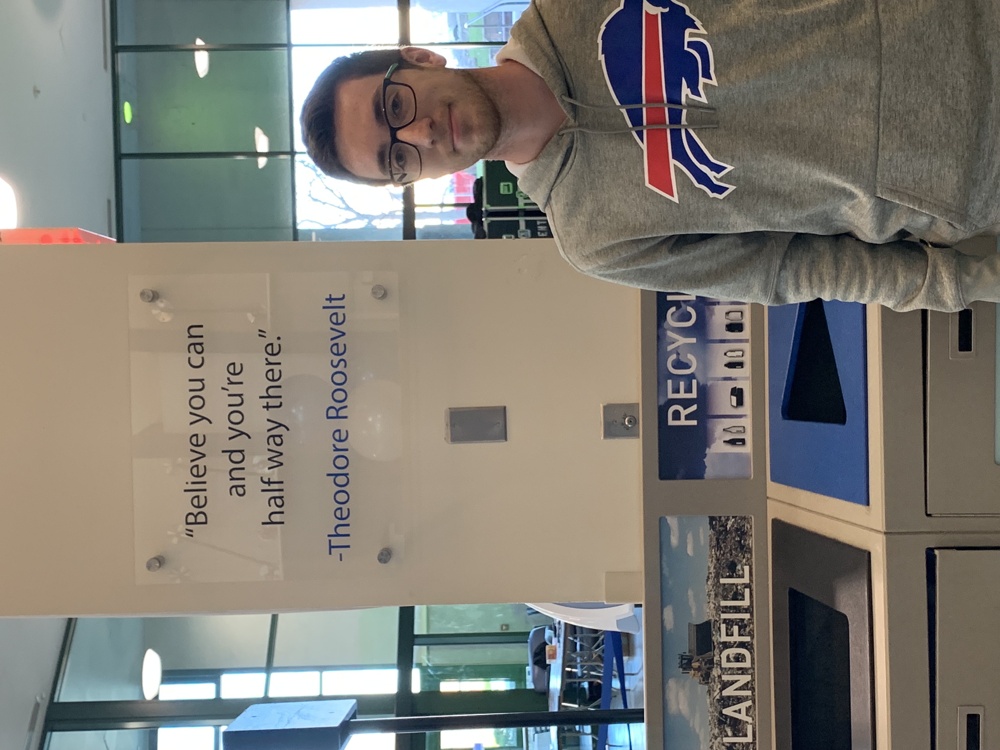

In [316]:
from IPython.display import Image
Image('nc2.jpeg')

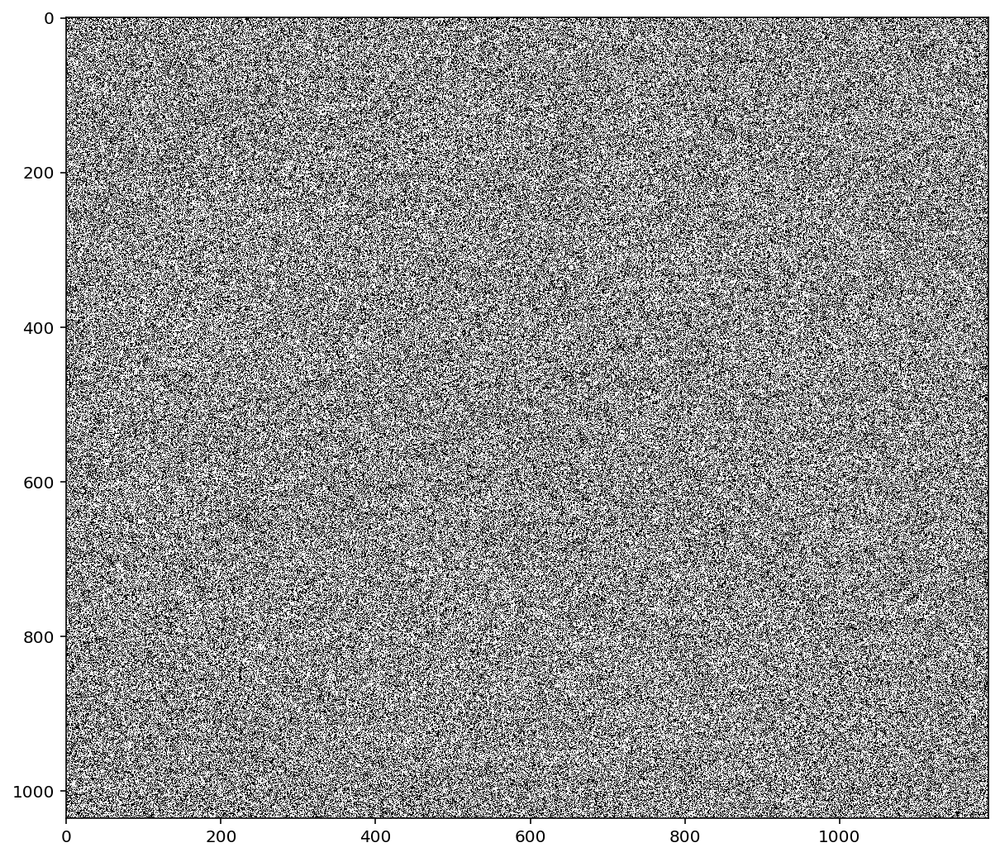

In [317]:
showImage(ub3)

In [318]:
ub3 = ub3[:,:,0]

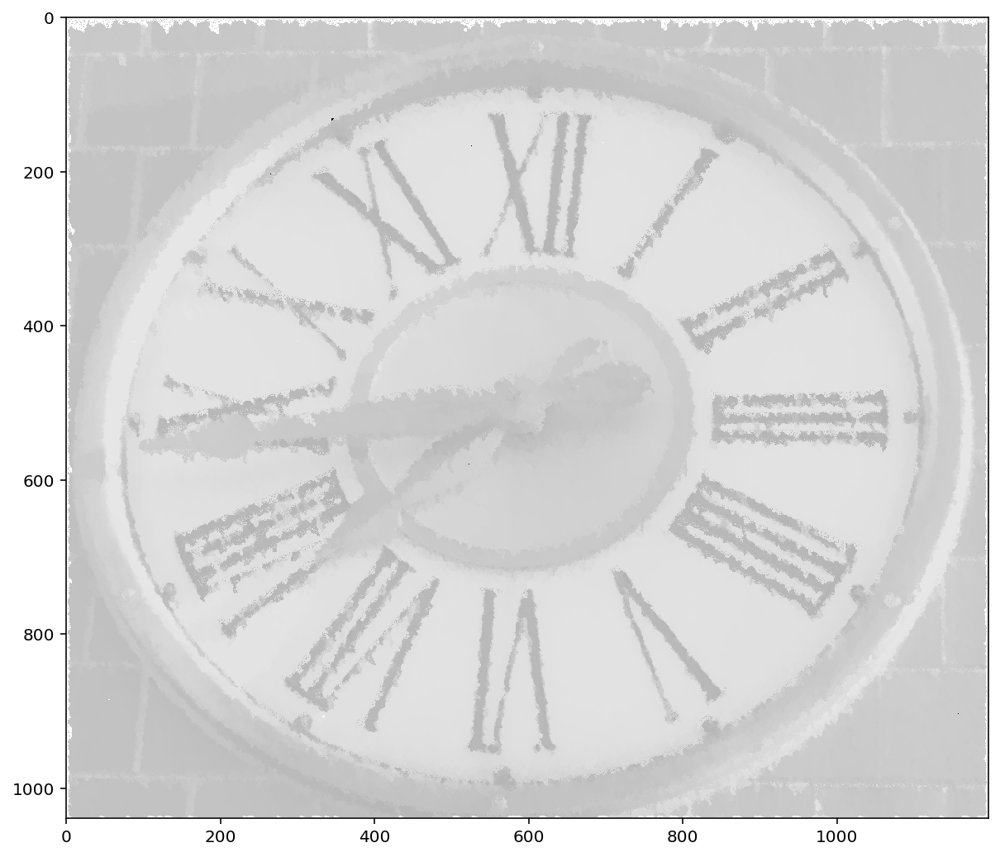

In [321]:
filter3 = addBorder(ub3,5//2)
showImage(median_filter(filter3,5))

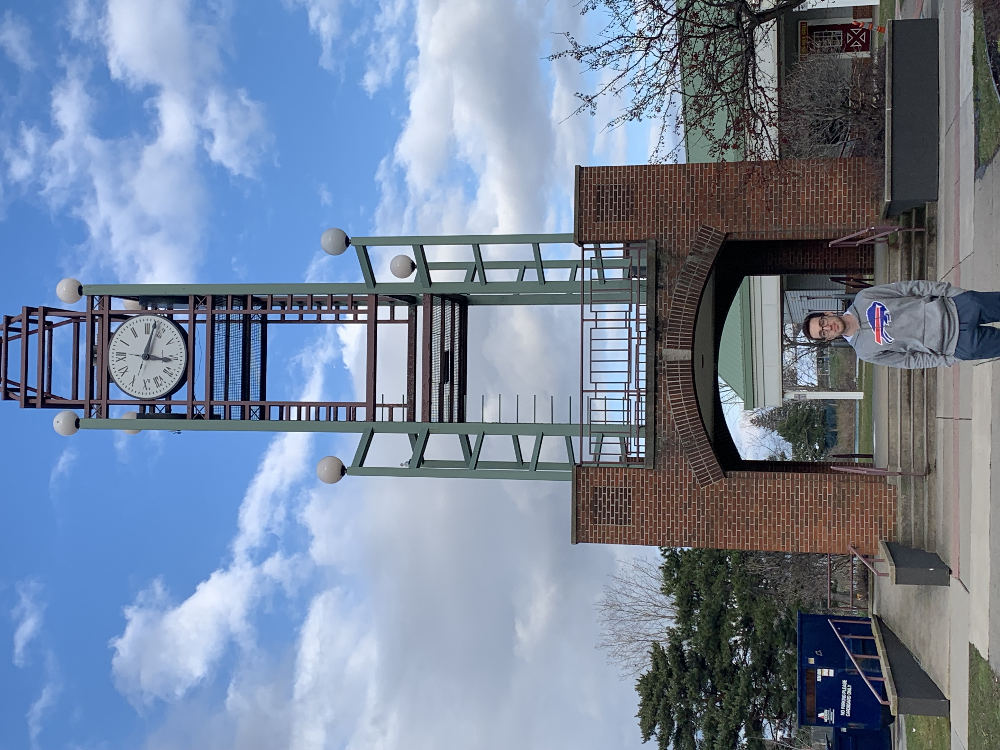

In [322]:
from IPython.display import Image
Image('nc3.jpeg')

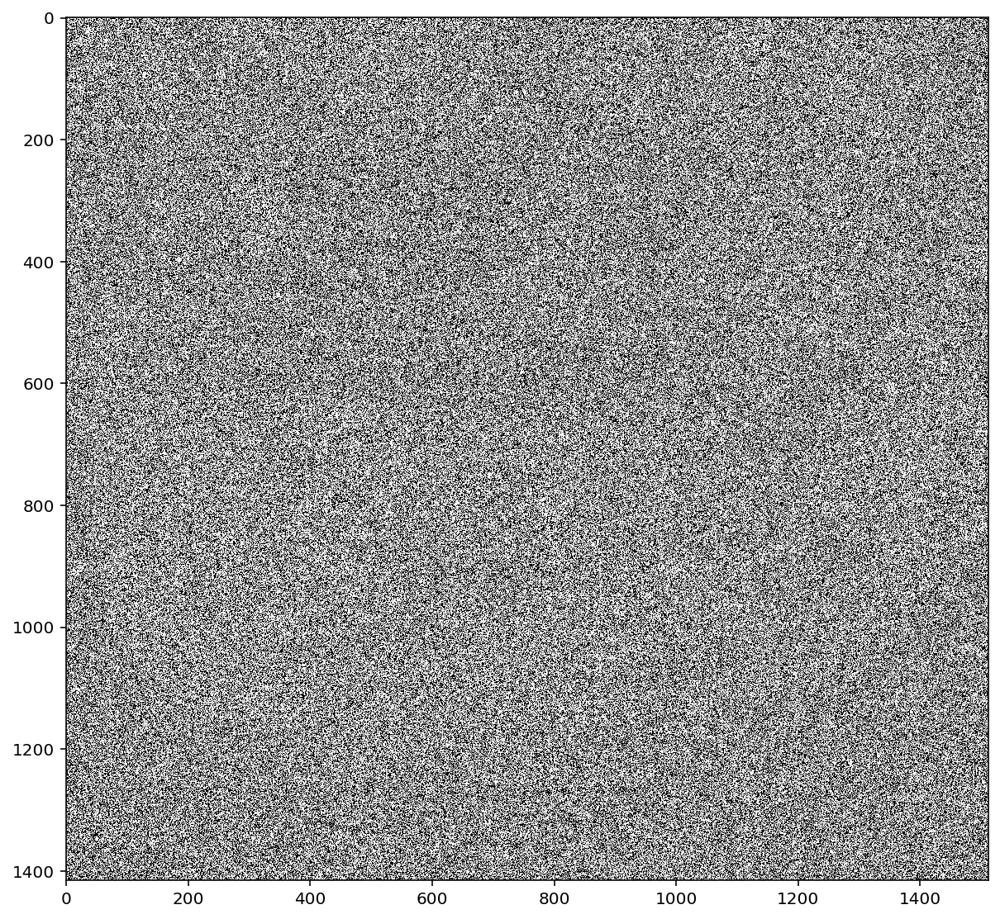

In [323]:
showImage(ub4)

In [324]:
ub4 = ub4[:,:,0]

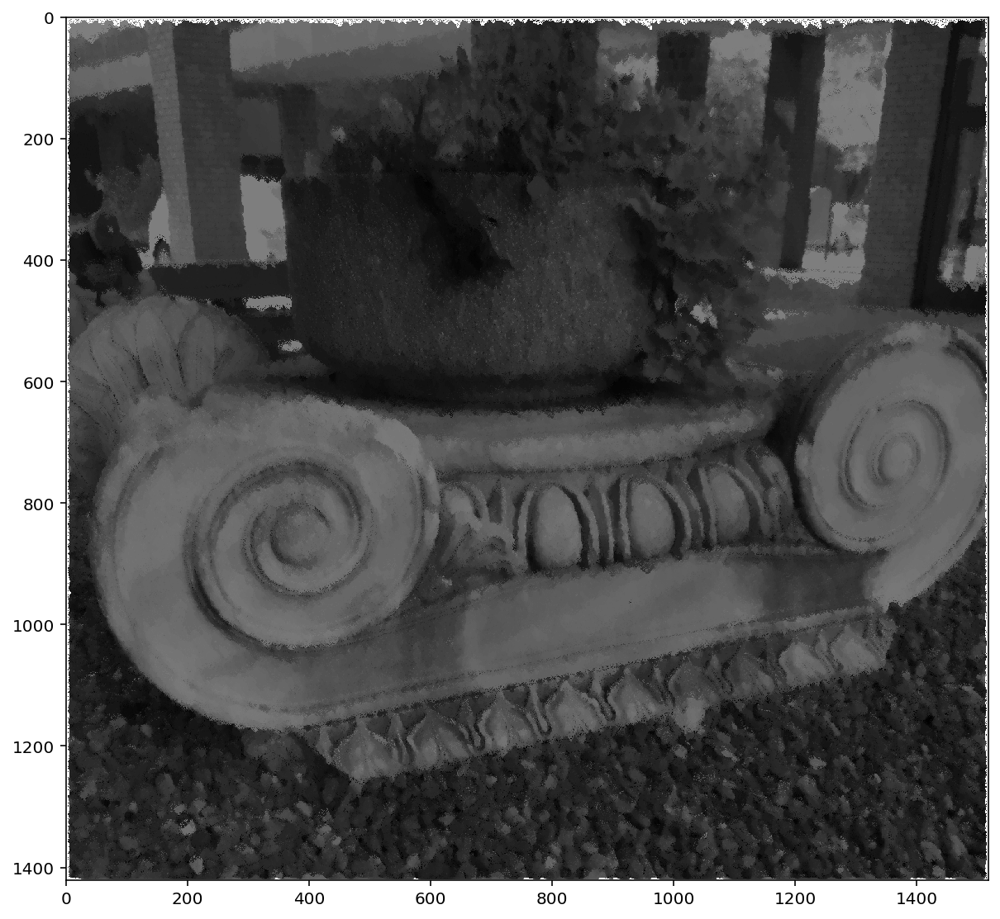

In [325]:
filter4 = addBorder(ub4,7//2)
showImage(median_filter(filter4,7))

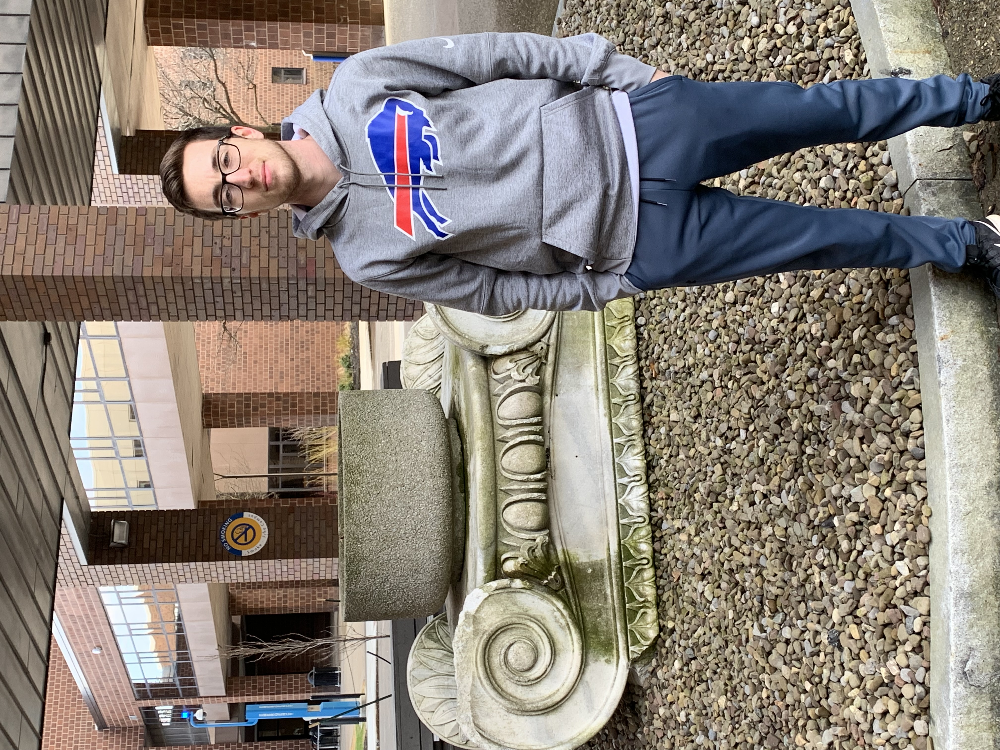

In [326]:
from IPython.display import Image
Image('nc4.jpeg')